# RUSSO_FINAL PROJECT

# Deep learning for time series

## Libraries import and parameters setup

In [1]:
# basic imports
import os
import numpy.random as rnd
import pandas as pd
import numpy as np
import pandas_ta as ta
from pathlib import Path
import seaborn as sns
import datetime as dt

# Financial data collection
import yfinance as yf

# Missing data visualization
import missingno as msno

# settings
pd.set_option('display.max_columns', 30)
pd.set_option('display.max_rows', 1000)

# import boruta
from boruta import BorutaPy

# warnings
import warnings
warnings.filterwarnings('ignore')

# plotting & outputs
from pprint import pprint
import matplotlib.pyplot as plt
import matplotlib as mpl
plt.style.use('seaborn')
mpl.rcParams['figure.figsize'] = [10.0, 5.0] 
mpl.rcParams["legend.frameon"] = False
mpl.rcParams['figure.dpi']=150

# sklearn imports
from sklearn.preprocessing import RobustScaler
from sklearn.cluster import KMeans
from minisom import MiniSom
from sklearn.model_selection import train_test_split
from sklearn.model_selection import TimeSeriesSplit, cross_val_score
from sklearn.base import BaseEstimator, TransformerMixin

# metrics
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score
from sklearn.metrics import classification_report, ConfusionMatrixDisplay
from sklearn.metrics import plot_confusion_matrix, auc, roc_curve, plot_roc_curve

# import classifiers
from sklearn.ensemble import RandomForestClassifier


# tensorflow
import tensorflow as tf
from tensorflow.keras.utils import plot_model
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator 

from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy 
from tensorflow.keras.metrics import BinaryAccuracy, Accuracy, AUC, Precision, Recall
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.layers import LSTM, Dropout, Dense, GRU

# define seed
def set_seeds(seed=42): 
    random.seed(seed)
    np.random.seed(seed)
    tf.random.set_seed(seed)

# kerastuner
import keras_tuner as kt
from kerastuner import HyperParameter, HyperParameters
from kerastuner.tuners import RandomSearch, BayesianOptimization, Hyperband

from functools import partial

# Part I: Features Engineering

## Data collection with yfinance

In [2]:
# Retrieving of data from yahooFinance

# Assets of choice
amd=yf.download('AMD', start="1990-01-01", end="2022-01-05",progress=False)
jpm=yf.download('JPM', start="1990-01-01", end="2022-01-05",progress=False)

# Data for global market feature creation
tyx=yf.download('^TYX', start="1990-01-01", end="2022-01-05",progress=False) # tresury yield 30 years
tnx=yf.download('^TNX', start="1990-01-01", end="2022-01-05",progress=False) # tresury yield 10 years
fvx=yf.download('^FVX', start="1990-01-01", end="2022-01-05",progress=False) # tresury yield 5 years
xau=yf.download('^XAU',start="1990-01-01", end="2022-01-05",progress=False)  # gold
vix=yf.download('^VIX',start="1990-01-01", end="2022-01-05",progress=False)  # VIX

In [3]:
# Save to Excel
amd.to_csv("AMD.csv")
jpm.to_csv("JPM.csv")
tyx.to_csv("thirtyyear_yield.csv")
tnx.to_csv("tenyear_yield.csv")
fvx.to_csv("fiveyear_yield.csv")
xau.to_csv("xau.csv")
vix.to_csv("vix.csv")

In [4]:
# Subsume into Pandas dataframes
AMD = pd.read_csv('AMD.csv', index_col=0, parse_dates=True)
JPM = pd.read_csv('JPM.csv', index_col=0, parse_dates=True)
TYX = pd.read_csv('thirtyyear_yield.csv', index_col=0, parse_dates=True)
TNX = pd.read_csv('tenyear_yield.csv', index_col=0, parse_dates=True)
FVX = pd.read_csv('fiveyear_yield.csv', index_col=0, parse_dates=True)
XAU = pd.read_csv('xau.csv', index_col=0, parse_dates=True)
VIX = pd.read_csv('vix.csv', index_col=0, parse_dates=True)

## Data Cleaning and Feature Extraction
Check for missing values

In [6]:
# AMD
AMD.isna().sum()

Open         0
High         0
Low          0
Close        0
Adj Close    0
Volume       0
dtype: int64

In [7]:
# JPM
JPM.isna().sum()

Open         0
High         0
Low          0
Close        0
Adj Close    0
Volume       0
dtype: int64

In [8]:
# TYX
TYX.isna().sum()

Open         0
High         0
Low          0
Close        0
Adj Close    0
Volume       0
dtype: int64

In [9]:
# TNX
TNX.isna().sum()

Open         0
High         0
Low          0
Close        0
Adj Close    0
Volume       0
dtype: int64

In [10]:
# FVX
FVX.isna().sum()

Open         0
High         0
Low          0
Close        0
Adj Close    0
Volume       0
dtype: int64

In [11]:
# XAU
XAU.isna().sum()

Open         0
High         0
Low          0
Close        0
Adj Close    0
Volume       0
dtype: int64

In [12]:
# VIX
VIX.isna().sum()

Open         0
High         0
Low          0
Close        0
Adj Close    0
Volume       0
dtype: int64

### Feature creation

In [13]:
# Computation of assets returns

AMD['Returns']=AMD['Adj Close'].pct_change()
JPM['Returns']=JPM['Adj Close'].pct_change()

In [14]:
# Creation of feature matrix for the 2 assets

AMDfeat=AMD.copy()
JPMfeat=JPM.copy()

In [15]:
# If the two assets have the same lenght of dataframe we can define a lenght variable (useful later)

if len(AMDfeat)==len(JPMfeat):
    lenght=len(AMDfeat)

In [16]:
# Compute lagged returns 
# Lagged returns are then TURNED INTO BINARY DATA to help with the LSTM Neural Network
lags=range(1,55,5)

cols=[]
for i in lags:
    col= 'Ret %d' % i
    AMDfeat[col]=np.where(np.sign(AMDfeat['Returns'].shift(i))==1,1,0)
    JPMfeat[col]=np.where(np.sign(JPMfeat['Returns'].shift(i))==1,1,0)
    cols.append(col)

In [17]:
# Compute Momentum sign up to 10 days.
# The momentum is computed on alternated days with respect to the lagged returns to avoid overlap
# The momentum is the converted into a binary variable to aid with the classification problem
lags=range(2,56,5)

cols=[]
for i in lags:
    col= 'Mom %d' % i
    AMDfeat[col]=np.where(np.sign(AMDfeat['Adj Close']-AMDfeat['Adj Close'].shift(i))==1,1,0)
    JPMfeat[col]=np.where(np.sign(JPMfeat['Adj Close']-JPMfeat['Adj Close'].shift(i))==1,1,0)
    cols.append(col)
    
# INSERT COMMENT ON THE REPORT ABOUT NaN VALUES TURING INTO 0 AND WHY IT IS NOT A PROBLEM

### Computing volatility indicators:

In [18]:
# Rolling realised volatility
lags=range(2,25,3)

cols=[]
for i in lags:
    col= 'Real vol %d' % i
    AMDfeat[col]=AMDfeat['Returns'].rolling(i).std()
    JPMfeat[col]=JPMfeat['Returns'].rolling(i).std()
    cols.append(col)

In [19]:
#  Average True Range (ATM)

# Firstly compute High-low, Low-previous Adj Close, High-previous Adj Close
#Asset 1
AMDfeat['H-L']=AMD['High']-AMD['Low']
AMDfeat['H-AC']=AMD['High']-AMD['Adj Close'].shift()
AMDfeat['L-AC']=AMD['Low']-AMD['Adj Close'].shift()
#Asset 2
JPMfeat['H-L']=JPM['High']-JPM['Low']
JPMfeat['H-AC']=JPM['High']-JPM['Adj Close'].shift()
JPMfeat['L-AC']=JPM['Low']-JPM['Adj Close'].shift()

# Then compute ATM
lags=range(3,30,2)

cols=[]
for i in lags:
    col= 'ATM %d' % i
    AMDtruerange=np.max(pd.concat([AMDfeat['H-L'],np.abs(AMDfeat['H-AC']),np.abs(AMDfeat['L-AC'])], axis=1),axis=1)
    AMDfeat[col]=AMDtruerange.rolling(i).mean()
    JPMtruerange=np.max(pd.concat([JPMfeat['H-L'],np.abs(JPMfeat['H-AC']),np.abs(JPMfeat['L-AC'])], axis=1),axis=1)
    JPMfeat[col]=JPMtruerange.rolling(i).mean()
    cols.append(col)
    
# Lastly, we drop the columns created to compute the ATR as we do not want to use them as features
AMDfeat=AMDfeat.drop(columns=['H-L','H-AC','L-AC'])
JPMfeat=JPMfeat.drop(columns=['H-L','H-AC','L-AC'])

### Insertion of global market indicators
We use VIX, gold moving averages and the difference in long and short treasury yeald as additional features to represent global market conditions

In [20]:
# Now we append to the feature datasets global makrket indicators derived from VIX, gold and Treasury Yields

# VIX indicates the volatility of the SP500, we take the VIX values over some prior days
lags=range(1,30,5)

cols=[]
for i in lags:
    col= 'VIX %d' % i
    AMDfeat[col]=VIX['Adj Close'].shift(i)
    JPMfeat[col]=VIX['Adj Close'].shift(i)
    cols.append(col)

    
# Gold trends are a good measure of inflation, we take long term SMA 
lags=range(50,250,50)

cols=[]
for i in lags:
    col= 'Gold SMA %d' % i
    AMDfeat[col]=XAU['Adj Close'].rolling(i).mean()
    JPMfeat[col]=XAU['Adj Close'].rolling(i).mean()
    cols.append(col)


# The difference between the long term and the short term treasury yield 
# is used as a standard indicator for markets sentiment about inflation and growth

# Spread of 5 and 30 years treasury yield
AMDfeat['5-30 yield']=TYX['Adj Close']-FVX['Adj Close']
JPMfeat['5-30 yield']=TYX['Adj Close']-FVX['Adj Close']

# Spread of 5 and 10 years treasury yield
AMDfeat['5-10 yield']=TNX['Adj Close']-FVX['Adj Close']
JPMfeat['5-10 yield']=TNX['Adj Close']-FVX['Adj Close']

### Defining Labels

In [21]:
# Define target for assets. 
# Since we are aiming for a 5days return prediction the label should be based on the 5 days forward looking return

AMDfeat['Predict']= pd.Series([np.nan for x in range(len(AMDfeat.index))], index=AMDfeat.index)
JPMfeat['Predict']= pd.Series([np.nan for x in range(len(JPMfeat.index))], index=JPMfeat.index)

for i in range(len(AMDfeat.index)-5):
    AMDfeat['Predict'].iloc[i]=np.where(np.sign(np.log(AMD['Adj Close'].iloc[i+5]/AMD['Adj Close'].iloc[i]))==1,1,0)
    JPMfeat['Predict'].iloc[i]=np.where(np.sign(np.log(JPM['Adj Close'].iloc[i+5]/JPM['Adj Close'].iloc[i]))==1,1,0)

In [22]:
# Create technical indicators for equities
AMDfeat.ta.strategy('All')
JPMfeat.ta.strategy('All')

131it [00:16,  7.82it/s]
131it [00:14,  8.84it/s]


### Exploratory data analysis of assets feature datasets

In [23]:
# Plot of the missing features
msno.bar(AMDfeat)

<AxesSubplot:>

In [24]:
# Identifying feature indicators of AMD with more than 5% missing values and eliminating the column
amdnullsum=np.around(AMDfeat.isna().sum()/len(AMD)*100,2)>5
for i in range(len(amdnullsum)):
    if amdnullsum[i]==True:
        AMDfeat=AMDfeat.drop(columns=amdnullsum.index[i])

In [25]:
# The features with the most missing values have been eliminated,
# we are left with some features missing only some of the values

msno.bar(AMDfeat)

<AxesSubplot:>

In [26]:
# Now dropping remaining null values and columns we do not need as features
AMDfeat=AMDfeat.dropna()
AMDfeat=AMDfeat.drop(columns=['Open','High','Low','Close','Adj Close','Volume'])

<AxesSubplot:>

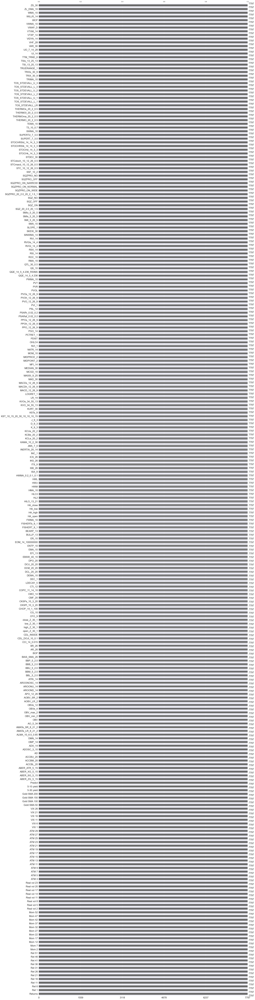

In [27]:
# The data has been cleaned
msno.bar(AMDfeat)

In [28]:
# We now repeat the same for the other asset
JPMfeat.ta.strategy('All')

131it [00:12, 10.12it/s]


In [29]:
msno.bar(JPMfeat)

<AxesSubplot:>

In [30]:
# Identifying feature indicators of AMD with more than 5% missing values and eliminating the column
jpmnullsum=np.around(JPMfeat.isna().sum()/lenght*100,2)>5
for i in range(len(jpmnullsum)):
    if jpmnullsum[i]==True:
        JPMfeat=JPMfeat.drop(columns=jpmnullsum.index[i])

In [31]:
msno.bar(JPMfeat)

<AxesSubplot:>

<AxesSubplot:>

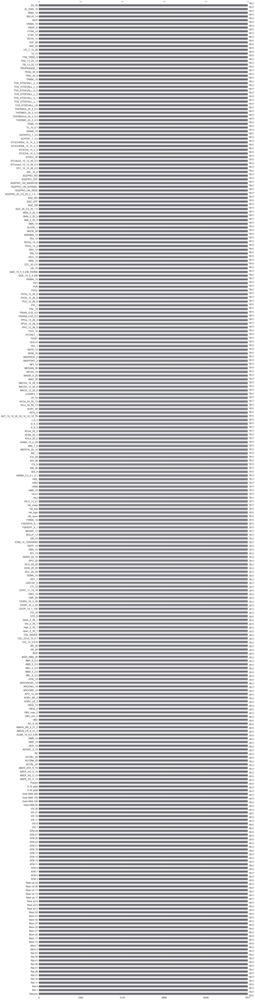

In [32]:
# Now dropping remaining null values and columns we do not want to usea as features
JPMfeat=JPMfeat.dropna()
JPMfeat=JPMfeat.drop(columns=['Open','High','Low','Close','Adj Close','Volume'])

# The data has been cleaned
msno.bar(JPMfeat)

### Address class imbalances

In [33]:
AMDfeat['Predict'].value_counts()

1.0    3957
0.0    3840
Name: Predict, dtype: int64

In [34]:
JPMfeat['Predict'].value_counts()

1.0    4219
0.0    3592
Name: Predict, dtype: int64

In [35]:
# Define class weight function
def weight_classes(dataframe):
    c0, c1 = np.bincount(dataframe['Predict'])
    w0=(1/c0)*(len(dataframe))/2 
    w1=(1/c1)*(len(dataframe))/2 
    return {0: w0, 1: w1}

In [36]:
# Check class weights
class_weightAMD= weight_classes(AMDfeat)
class_weightJPM = weight_classes(JPMfeat)
print(class_weightAMD)
print(class_weightJPM)

{0: 1.015234375, 1: 0.9852160727824109}
{0: 1.0872772828507795, 1: 0.9256932922493482}


In [37]:
# With the calculated weights, both classes gain equal weight

print(class_weightAMD[0] * AMDfeat['Predict'].value_counts()[0], class_weightAMD[1] * AMDfeat['Predict'].value_counts()[1])
print(class_weightJPM[0] * JPMfeat['Predict'].value_counts()[0], class_weightJPM[1] * JPMfeat['Predict'].value_counts()[1])

3898.4999999999995 3898.4999999999995
3905.5 3905.5


In [38]:
# Now we copy the target to an external array and delete it from the features dataframes for clarity
yamd=AMDfeat['Predict'].to_numpy()
yjpm=JPMfeat['Predict'].to_numpy()

# We then delete the label from the feature dataset
AMDfeat=AMDfeat.drop(columns='Predict')
JPMfeat=JPMfeat.drop(columns='Predict')

## Data Rescaling and Transforming

### Splitting of data into training, validation and testing dataset

In [39]:
# Splitting feature datasets into training, validation and testing

# AMD
AMD_train, AMD_test, yamd_train, yamd_test=train_test_split(AMDfeat,yamd,test_size=0.2,shuffle=False)
AMD_train, AMD_val, yamd_train, yamd_val=train_test_split(AMD_train,yamd_train,test_size=0.25,shuffle=False)

# JPM
JPM_train, JPM_test, yjpm_train, yjpm_test=train_test_split(JPMfeat,yjpm,test_size=0.2,shuffle=False)
JPM_train, JPM_val, yjpm_train, yjpm_val=train_test_split(JPM_train,yjpm_train,test_size=0.25,shuffle=False)

In [40]:
# To avoid information leaking in the 5days prediction, we remove the last 5 datapoints of the train and validation sets. 

# Train
deletable_rows_train_amd=AMD_train.index[-5:]
deletable_rows_train_jpm=JPM_train.index[-5:]

AMD_train=AMD_train.drop(index=deletable_rows_train_amd)
JPM_train=JPM_train.drop(index=deletable_rows_train_jpm)

yamd_train=yamd_train[:-5]
yjpm_train=yjpm_train[:-5]

# Validation
deletable_rows_val_amd=AMD_val.index[-5:]
deletable_rows_val_jpm=JPM_val.index[-5:]

AMD_val=AMD_val.drop(index=deletable_rows_val_amd)
JPM_val=JPM_val.drop(index=deletable_rows_val_jpm)

yamd_val=yamd_val[:-5]
yjpm_val=yjpm_val[:-5]

In [41]:
# Check the train and test data size
print(f"Train and Test Size for AMD: {AMD_train.shape}, {yamd_train.shape}, {AMD_val.shape}, {yamd_val.shape}, {AMD_test.shape}, {yamd_test.shape}")
print(f"Train and Test Size for JPM: {JPM_train.shape}, {yjpm_train.shape}, {JPM_val.shape}, {yjpm_val.shape}, {JPM_test.shape}, {yjpm_test.shape}")

Train and Test Size for AMD: (4672, 267), (4672,), (1555, 267), (1555,), (1560, 267), (1560,)
Train and Test Size for JPM: (4681, 267), (4681,), (1557, 267), (1557,), (1563, 267), (1563,)


### Creation of appropriate ColumnTranformer

Binary features are not scaled, other features are scaled usign RobustScaler in order to account for outliers

| Feature | Choice of Scaler | 
| --- | --- | 
| Binary features | Not scaled |
|  Other features | RobustScaler |

### SCALER HAS TO BE FIXED PROPERLY

In [42]:
# Use RobustScaler to account for outliers
scaler_amd=RobustScaler()
scaler_jpm=RobustScaler()

In [43]:
# Fit and transform training set
AMD_train_scaled=scaler_amd.fit_transform(AMD_train)
JPM_train_scaled=scaler_jpm.fit_transform(JPM_train)

# Transform testing set and validation set with the scaler fitted on the training set
AMD_val_scaled=scaler_amd.transform(AMD_val)
JPM_val_scaled=scaler_jpm.transform(JPM_val)
AMD_test_scaled=scaler_amd.transform(AMD_test)
JPM_test_scaled=scaler_jpm.transform(JPM_test)

## Feature Selection

### BorutaPy preliminary analysis

We will first start with an "All relevant" approach with a preliminary BorutaPy analysis. 
Then, we will address multicollinearity both with K-means and SOM methods

In [44]:
# Define random forest classifier for both assets with appropriate class weights
forestclass_amd = RandomForestClassifier(n_jobs=-1,class_weight=class_weightAMD,random_state=42,max_depth=5)
forestclass_jpm = RandomForestClassifier(n_jobs=-1,class_weight=class_weightJPM,random_state=42,max_depth=5)

# Train the models
forestclass_amd.fit(AMD_train_scaled, yamd_train)
forestclass_jpm.fit(JPM_train_scaled, yjpm_train)

RandomForestClassifier(class_weight={0: 1.0872772828507795,
                                     1: 0.9256932922493482},
                       max_depth=5, n_jobs=-1, random_state=42)

### AMD

In [45]:
# Define Boruta feature selection methods
feat_selector_amd = BorutaPy(forestclass_amd, n_estimators='auto', verbose=1, random_state=0)

# Find all relevant features
# Takes input in array format not as dataframe
feat_selector_amd.fit(AMD_train_scaled, yamd_train) 

# Call transform() on AMD to filter it down to selected features
AMD_train_filtered = feat_selector_amd.transform(AMD_train_scaled)

Iteration: 1 / 100
Iteration: 2 / 100
Iteration: 3 / 100
Iteration: 4 / 100
Iteration: 5 / 100
Iteration: 6 / 100
Iteration: 7 / 100
Iteration: 8 / 100
Iteration: 9 / 100
Iteration: 10 / 100
Iteration: 11 / 100
Iteration: 12 / 100
Iteration: 13 / 100
Iteration: 14 / 100
Iteration: 15 / 100
Iteration: 16 / 100
Iteration: 17 / 100
Iteration: 18 / 100
Iteration: 19 / 100
Iteration: 20 / 100
Iteration: 21 / 100
Iteration: 22 / 100
Iteration: 23 / 100
Iteration: 24 / 100
Iteration: 25 / 100
Iteration: 26 / 100
Iteration: 27 / 100
Iteration: 28 / 100
Iteration: 29 / 100
Iteration: 30 / 100
Iteration: 31 / 100
Iteration: 32 / 100
Iteration: 33 / 100
Iteration: 34 / 100
Iteration: 35 / 100
Iteration: 36 / 100
Iteration: 37 / 100
Iteration: 38 / 100
Iteration: 39 / 100
Iteration: 40 / 100
Iteration: 41 / 100
Iteration: 42 / 100
Iteration: 43 / 100
Iteration: 44 / 100
Iteration: 45 / 100
Iteration: 46 / 100
Iteration: 47 / 100
Iteration: 48 / 100
Iteration: 49 / 100
Iteration: 50 / 100
Iteration

In [46]:
feature_names_amd = AMDfeat.columns

# Zip names, ranks, and decisions in a single iterable
feature_ranks_amd = list(zip(feature_names_amd, 
                         feat_selector_amd.ranking_, 
                         feat_selector_amd.support_))

# Iterate through and print out the results
for feat in feature_ranks_amd:
    print(f'Feature: {feat[0]:<30} Rank: {feat[1]:<5} Keep: {feat[2]}')

Feature: Returns                        Rank: 47    Keep: False
Feature: Ret 1                          Rank: 64    Keep: False
Feature: Ret 6                          Rank: 89    Keep: False
Feature: Ret 11                         Rank: 86    Keep: False
Feature: Ret 16                         Rank: 66    Keep: False
Feature: Ret 21                         Rank: 87    Keep: False
Feature: Ret 26                         Rank: 83    Keep: False
Feature: Ret 31                         Rank: 74    Keep: False
Feature: Ret 36                         Rank: 76    Keep: False
Feature: Ret 41                         Rank: 75    Keep: False
Feature: Ret 46                         Rank: 67    Keep: False
Feature: Ret 51                         Rank: 82    Keep: False
Feature: Mom 2                          Rank: 67    Keep: False
Feature: Mom 7                          Rank: 41    Keep: False
Feature: Mom 12                         Rank: 60    Keep: False
Feature: Mom 17                         

In [47]:
selected_amd_features = pd.DataFrame({'Feature':feature_names_amd,
                                     'Ranking':feat_selector_amd.ranking_})

selected_amd_features=selected_amd_features[selected_amd_features['Ranking']==1]
selected_amd_features

,Feature,Ranking
25,Real vol 8,1
26,Real vol 11,1
27,Real vol 14,1
28,Real vol 17,1
29,Real vol 20,1
30,Real vol 23,1
32,ATM 5,1
33,ATM 7,1
34,ATM 9,1
35,ATM 11,1


Subsume the feature selected by the BorutaPy algorithm into a dataframe for further selection with K-means and SOM

In [48]:
# Turn the train, validation and test arrays into datasets
AMD_train_filtered=pd.DataFrame(AMD_train_scaled,columns=AMDfeat.columns,index=AMDfeat.index[:len(AMD_train_scaled)])
AMD_val_filtered=pd.DataFrame(AMD_val_scaled,columns=AMDfeat.columns,index=AMDfeat.index[len(AMD_train_scaled)+5:-(len(AMD_test_scaled)+5)])
AMD_test_filtered=pd.DataFrame(AMD_test_scaled,columns=AMDfeat.columns,index=AMDfeat.index[len(AMD_train_scaled)+len(AMD_val_scaled)+10:])

In [49]:
# Now we can keep only the features selected by BorutaPy
AMD_train_filtered.drop(AMD_train_filtered.columns.difference(selected_amd_features['Feature'].values), 1, inplace=True)

# It is important to select the same features on the test set and validation set
AMD_val_filtered.drop(AMD_val_filtered.columns.difference(selected_amd_features['Feature'].values), 1, inplace=True)
AMD_test_filtered.drop(AMD_test_filtered.columns.difference(selected_amd_features['Feature'].values), 1, inplace=True)

### JPM

In [50]:
# Define Boruta feature selection method for second asset
feat_selector_jpm = BorutaPy(forestclass_jpm, n_estimators=150, verbose=1, random_state=0)

# Find all relevant features
# Takes input in array format not as dataframe
feat_selector_jpm.fit(JPM_train_scaled, yjpm_train)

# Call transform() on the JPM to filter it down to selected features
JPM_train_filtered = feat_selector_jpm.transform(JPM_train_scaled)

Iteration: 1 / 100
Iteration: 2 / 100
Iteration: 3 / 100
Iteration: 4 / 100
Iteration: 5 / 100
Iteration: 6 / 100
Iteration: 7 / 100
Iteration: 8 / 100
Iteration: 9 / 100
Iteration: 10 / 100
Iteration: 11 / 100
Iteration: 12 / 100
Iteration: 13 / 100
Iteration: 14 / 100
Iteration: 15 / 100
Iteration: 16 / 100
Iteration: 17 / 100
Iteration: 18 / 100
Iteration: 19 / 100
Iteration: 20 / 100
Iteration: 21 / 100
Iteration: 22 / 100
Iteration: 23 / 100
Iteration: 24 / 100
Iteration: 25 / 100
Iteration: 26 / 100
Iteration: 27 / 100
Iteration: 28 / 100
Iteration: 29 / 100
Iteration: 30 / 100
Iteration: 31 / 100
Iteration: 32 / 100
Iteration: 33 / 100
Iteration: 34 / 100
Iteration: 35 / 100
Iteration: 36 / 100
Iteration: 37 / 100
Iteration: 38 / 100
Iteration: 39 / 100
Iteration: 40 / 100
Iteration: 41 / 100
Iteration: 42 / 100
Iteration: 43 / 100
Iteration: 44 / 100
Iteration: 45 / 100
Iteration: 46 / 100
Iteration: 47 / 100
Iteration: 48 / 100
Iteration: 49 / 100
Iteration: 50 / 100
Iteration

In [51]:
feature_names = JPMfeat.columns

# Zip my names, ranks, and decisions in a single iterable
feature_ranks_jpm = list(zip(feature_names, 
                         feat_selector_jpm.ranking_, 
                         feat_selector_jpm.support_))

# Iterate through and print out the results
for feat in feature_ranks_jpm:
    print(f'Feature: {feat[0]:<30} Rank: {feat[1]:<5} Keep: {feat[2]}')

Feature: Returns                        Rank: 133   Keep: False
Feature: Ret 1                          Rank: 168   Keep: False
Feature: Ret 6                          Rank: 164   Keep: False
Feature: Ret 11                         Rank: 176   Keep: False
Feature: Ret 16                         Rank: 168   Keep: False
Feature: Ret 21                         Rank: 168   Keep: False
Feature: Ret 26                         Rank: 168   Keep: False
Feature: Ret 31                         Rank: 162   Keep: False
Feature: Ret 36                         Rank: 159   Keep: False
Feature: Ret 41                         Rank: 183   Keep: False
Feature: Ret 46                         Rank: 171   Keep: False
Feature: Ret 51                         Rank: 183   Keep: False
Feature: Mom 2                          Rank: 153   Keep: False
Feature: Mom 7                          Rank: 150   Keep: False
Feature: Mom 12                         Rank: 154   Keep: False
Feature: Mom 17                         

In [52]:
selected_jpm_features = pd.DataFrame({'Feature':feature_names,
                                     'Ranking':feat_selector_jpm.ranking_}) 

selected_jpm_features=selected_jpm_features[selected_jpm_features['Ranking']==1]
selected_jpm_features

,Feature,Ranking
51,Gold SMA 50,1
53,Gold SMA 150,1
54,Gold SMA 200,1
55,5-30 yield,1
56,5-10 yield,1
57,ABER_ZG_5_15,1
58,ABER_SG_5_15,1
61,ACCBL_20,1
64,AD,1
65,ADOSC_3_10,1


In [53]:
# Turn the train, validation and test arrays into datasets
JPM_train_filtered=pd.DataFrame(JPM_train_scaled,columns=JPMfeat.columns,index=JPMfeat.index[:len(JPM_train_scaled)])
JPM_val_filtered=pd.DataFrame(JPM_val_scaled,columns=JPMfeat.columns,index=JPMfeat.index[len(JPM_train_scaled)+5:-(len(JPM_test_scaled)+5)])
JPM_test_filtered=pd.DataFrame(JPM_test_scaled,columns=JPMfeat.columns,index=JPMfeat.index[len(JPM_train_scaled)+len(JPM_val_scaled)+10:])

In [54]:
# Now we can keep only the features selected by BorutaPy
JPM_train_filtered.drop(JPM_train_filtered.columns.difference(selected_jpm_features['Feature'].values), 1, inplace=True)

# It is important to select the same features on the test and validation set
JPM_val_filtered.drop(JPM_val_filtered.columns.difference(selected_jpm_features['Feature'].values), 1, inplace=True)
JPM_test_filtered.drop(JPM_test_filtered.columns.difference(selected_jpm_features['Feature'].values), 1, inplace=True)

## K-means clustering
We know use the remaingin features to perform a K-means clustering which will address the non-linearity in the data.
First, we produce an inertia-based elbow plot to make a decision on the number of clusters, then we will run the actual K-means clustering algorithm

### Elbow plots
We create inertia elbow plots do decide on the appropriate number oof clusters 

In [55]:
n_clusters_amd = range(2, 44)
n_clusters_jpm = range(2, 44)
inertia_amd = []
inertia_jpm = []

# AMD
for n in n_clusters_amd:
    kmeans_amd = KMeans(n_clusters=n)
    kmeans_amd.fit(AMD_train_filtered.T)  # It is important to transpose the dataframe
    inertia_amd.append(kmeans_amd.inertia_)

# JPM
for n in n_clusters_jpm:
    kmeans_jpm = KMeans(n_clusters=n)
    kmeans_jpm.fit(JPM_train_filtered.T)  # It is important to transpose the dataframe
    inertia_jpm.append(kmeans_jpm.inertia_)

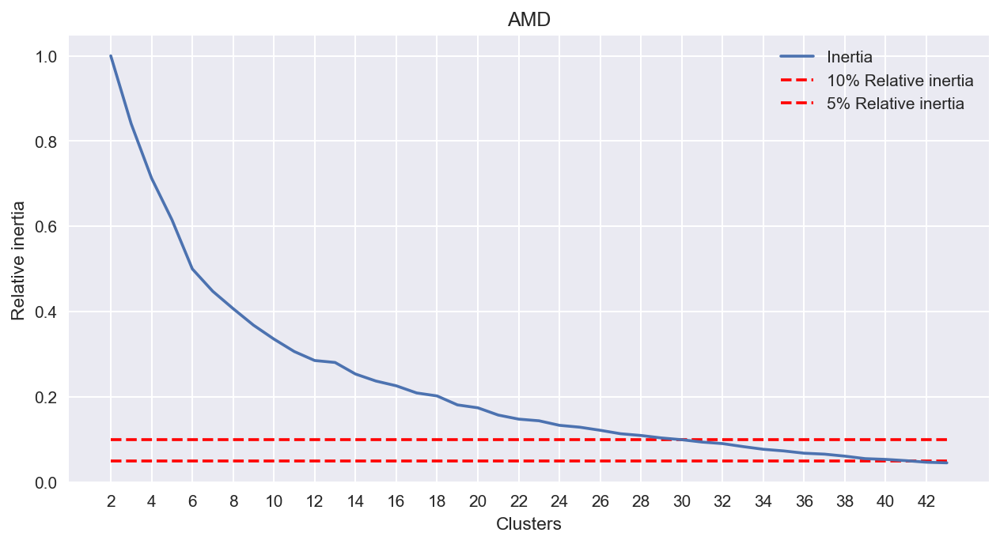

In [56]:
# Plot AMD
plt.plot(n_clusters_amd, np.divide(inertia_amd,inertia_amd[0]))
plt.hlines(0.1, n_clusters_amd[0], n_clusters_amd[-1], 'r', linestyles='dashed')
plt.hlines(0.05, n_clusters_amd[0], n_clusters_amd[-1], 'r', linestyles='dashed')
plt.xlabel('Clusters')
plt.xticks(np.arange(min(n_clusters_amd), max(n_clusters_amd)+1, 2.0))
plt.ylabel('Relative inertia')
plt.title('AMD')
plt.legend(['Inertia', '10% Relative inertia', '5% Relative inertia']);
plt.savefig('AMD_elbow.png',bbox_inches="tight")
plt.show()

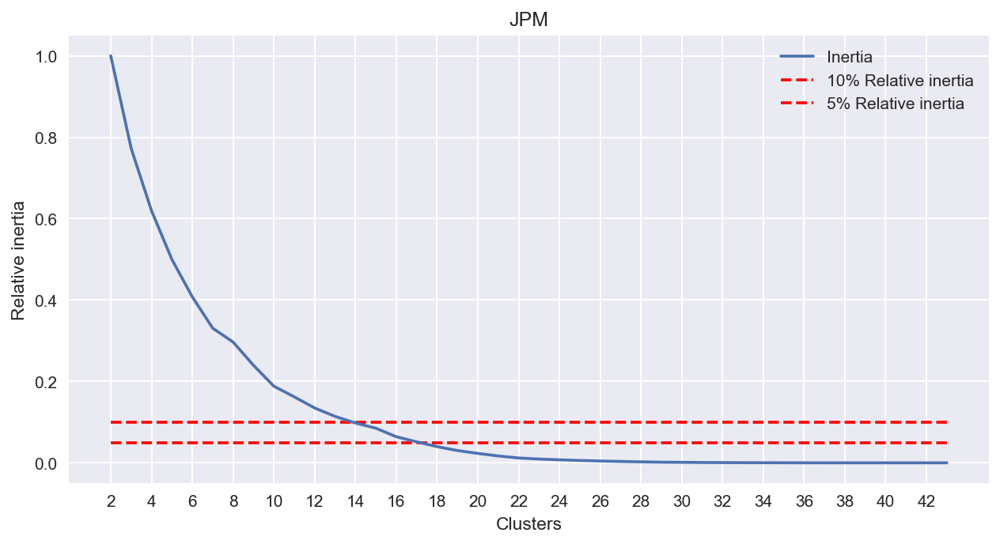

In [57]:
# Plot JPM
plt.plot(n_clusters_jpm, np.divide(inertia_jpm,inertia_jpm[0]))
plt.hlines(0.1, n_clusters_jpm[0], n_clusters_jpm[-1], 'r', linestyles='dashed')
plt.hlines(0.05, n_clusters_jpm[0], n_clusters_jpm[-1], 'r', linestyles='dashed')
plt.xlabel('Clusters')
plt.xticks(np.arange(min(n_clusters_jpm), max(n_clusters_jpm)+1, 2.0))
plt.ylabel('Relative inertia')
plt.title('JPM')
plt.legend(['Inertia', '10% Relative inertia', '5% Relative inertia']);
plt.savefig('JPM_elbow.png',bbox_inches="tight")
plt.show()

### Clustering

In [58]:
# Create clusterer

# AMD
cluster_amd=KMeans(n_clusters=41) #5% inertia

# JPM
cluster_jpm=KMeans(n_clusters=15) #5% inertia

In [59]:
# Fit Model
cluster_amd.fit(AMD_train_filtered.T)
cluster_jpm.fit(JPM_train_filtered.T)


# Assign Label
labels_amd = cluster_amd.predict(AMD_train_filtered.T)
labels_jpm = cluster_jpm.predict(JPM_train_filtered.T)

In [60]:
# Create dataframe to hold cluster details for AMD
AMD_kmeans = pd.DataFrame({'Cluster': labels_amd, 
                    'Feature': AMD_train_filtered.columns}
                     ).sort_values(by=['Cluster'], axis = 0)

AMD_kmeans = AMD_kmeans.reset_index(drop=True)
AMD_kmeans

,Cluster,Feature
0,0,Gold SMA 100
1,0,Gold SMA 150
2,0,Gold SMA 50
3,0,Gold SMA 200
4,1,ATM 15
5,1,ATM 5
6,1,ATM 7
7,1,ATM 9
8,1,ATM 11
9,1,ATM 13


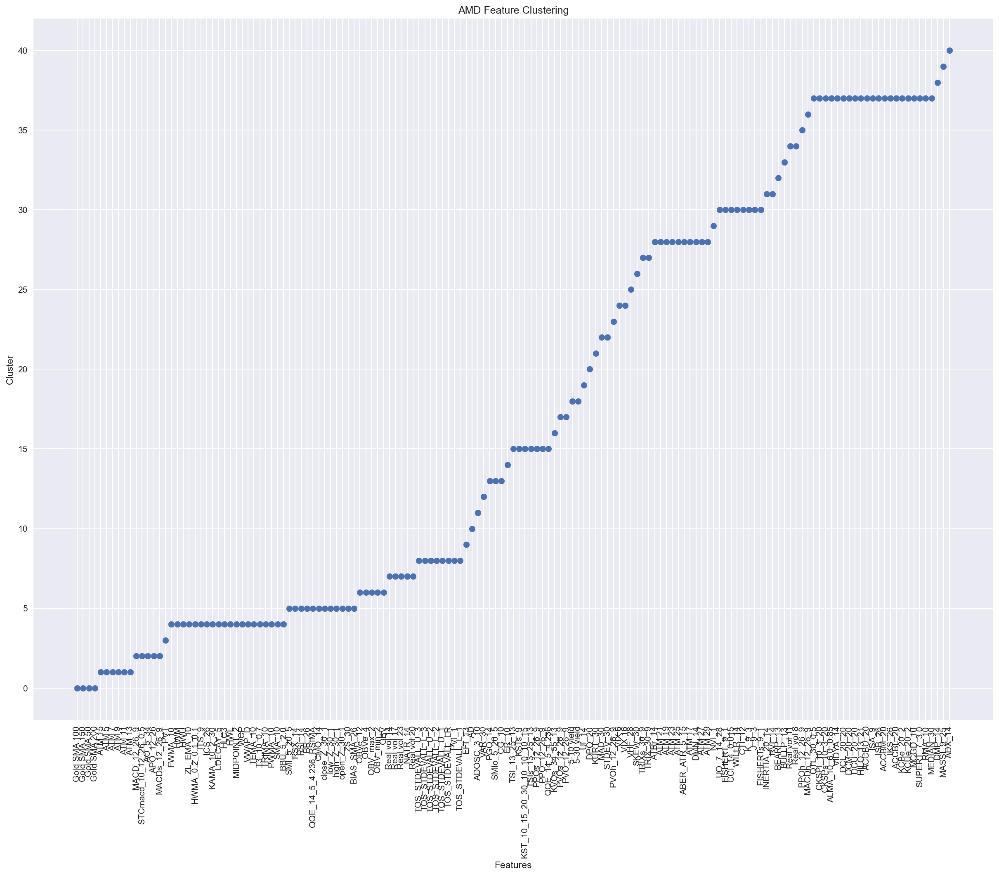

In [61]:
# Plot of KMeans AMD scatter plot
plt.figure(figsize=(20,15))
plt.scatter(AMD_kmeans.Feature, AMD_kmeans.Cluster)
plt.xlabel('Features')
plt.xticks(rotation='vertical')
plt.ylabel('Cluster')
plt.title('AMD Feature Clustering');
plt.savefig('AMD_clusters.png',bbox_inches="tight")
plt.show()

In [62]:
# Create dataframe to hold cluster details for JPM
JPM_kmeans = pd.DataFrame({'Cluster': labels_jpm, 
                    'Feature': JPM_train_filtered.columns}
                     ).sort_values(by=['Cluster'], axis = 0)

JPM_kmeans = JPM_kmeans.reset_index(drop=True)
JPM_kmeans

,Cluster,Feature
0,0,ICS_26
1,0,KCUe_20_2
2,0,ITS_9
3,0,HWMA_0.2_0.1_0.1
4,0,HWM
5,0,DCU_20_20
6,0,BBM_5_2.0
7,0,KAMA_10_2_30
8,0,SINWMA_14
9,0,BBL_5_2.0


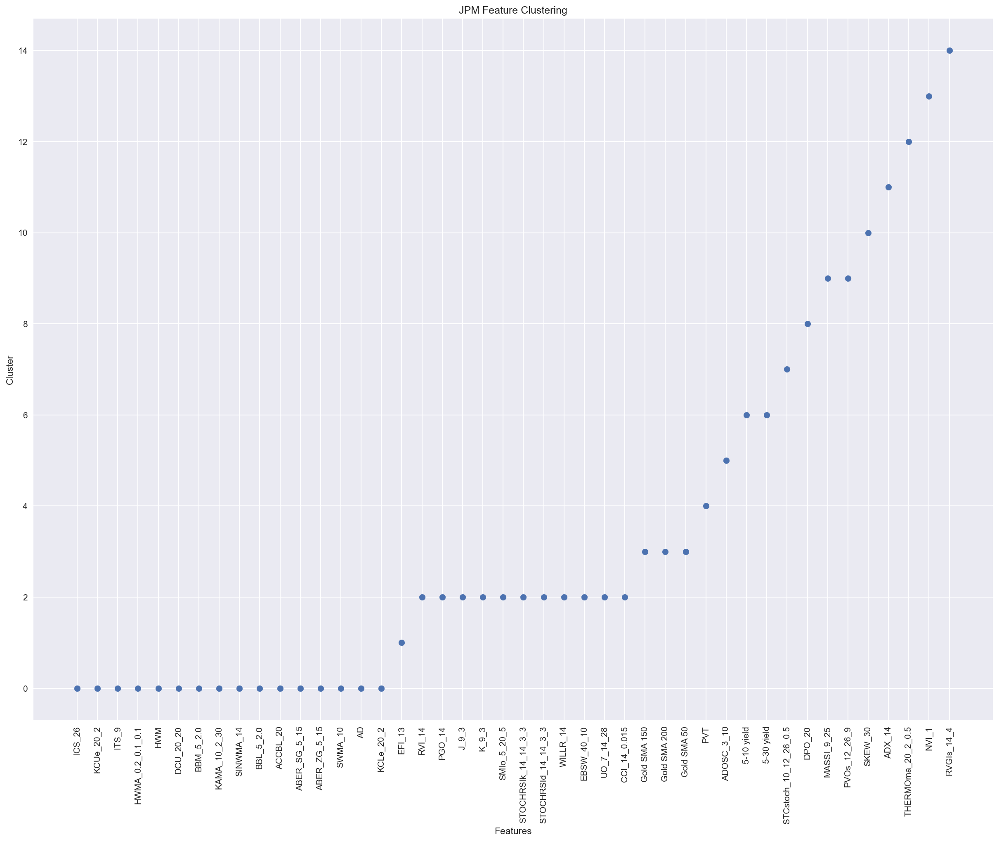

In [63]:
# Plot of KMeans JPM scatter plot
plt.figure(figsize=(20,15))
plt.scatter(JPM_kmeans.Feature, JPM_kmeans.Cluster)
plt.xlabel('Features')
plt.xticks(rotation='vertical')
plt.ylabel('Cluster')
plt.title('JPM Feature Clustering');
plt.savefig('JPM_clusters.png',bbox_inches="tight")
plt.show()

## Self Organising Maps
We train and fit a $N\times N$ SOM algorithm to identify redundancy in the features selected with BorutaPy

### AMD

In [64]:
# Initialize a NxN SOM
N_feat_amd=len(AMD_train_filtered.columns)
size_amd=int(5*np.sqrt(N_feat_amd))

som_amd = MiniSom(size_amd, size_amd, N_feat_amd, learning_rate=0.5, sigma=3, random_seed=42)

# Initialize with randon weights
som_amd.random_weights_init(AMD_train_filtered.values)

# Trains SOM with 10000 iterations
som_amd.train_batch(AMD_train_filtered.values,10000, verbose=True)

 [ 10000 / 10000 ] 100% - 0:00:00 left 
 quantization error: 3.7844088709428


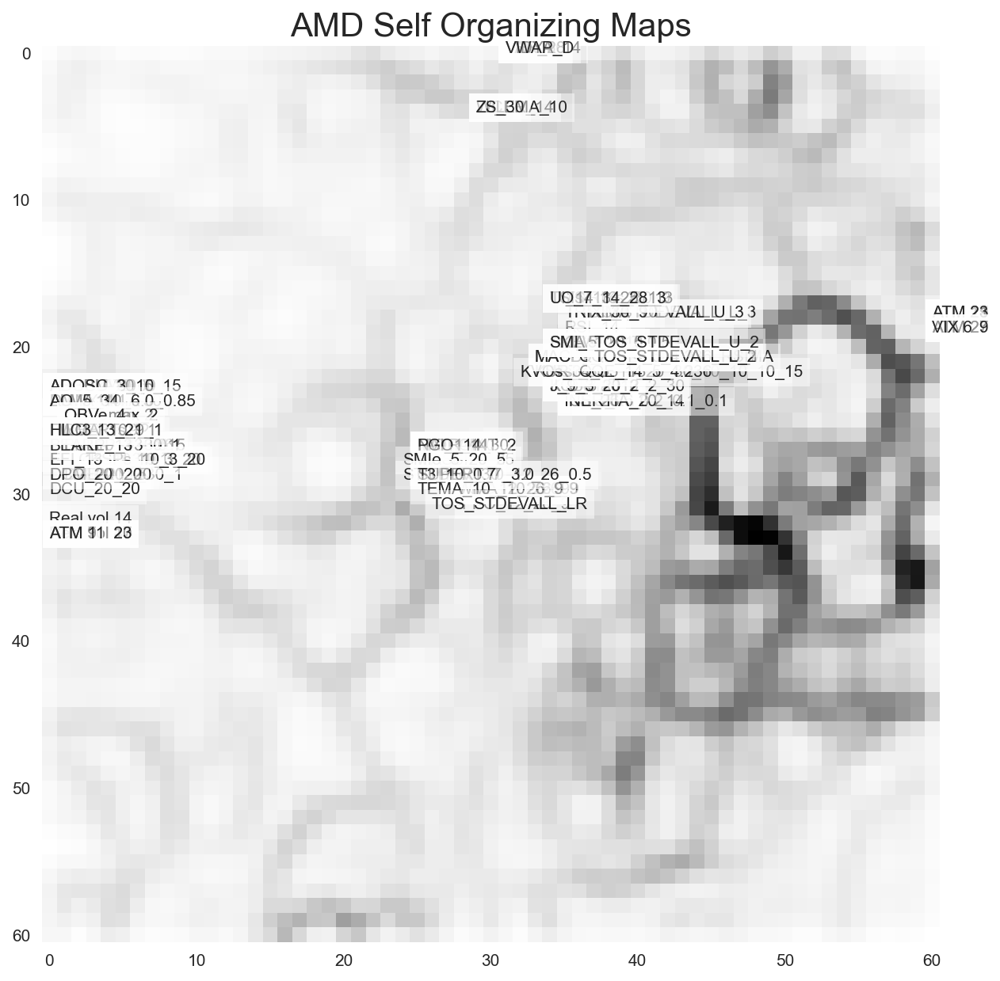

In [65]:
# Plot SOM
plt.figure(figsize=(20, 10))
for ix in range(len(AMD_train_filtered.columns)):
    winner_amd = som_amd.winner(AMD_train_filtered.values[ix])
    plt.text(winner_amd[0], winner_amd[1], AMD_train_filtered.columns[ix], bbox=dict(facecolor='white', alpha=0.5, lw=0)) 
plt.imshow(som_amd.distance_map())
plt.grid(False)
plt.style.use('fivethirtyeight')
plt.title('AMD Self Organizing Maps');
plt.savefig('AMD_SOM.png',bbox_inches="tight")
plt.show()

In [66]:
# Subsume corresponding features into a dataframe
AMD_som=np.zeros([len(AMD_train_filtered.columns),2])

for i in range(len(AMD_train_filtered.columns)):
    winner_amd = som_amd.winner(AMD_train_filtered.values[i])
    AMD_som[i,0]=winner_amd[0]
    AMD_som[i,1]=winner_amd[1]
    #print(winner_amd[0], winner_amd[1], AMD_train_filtered.columns[ix])
    
AMD_som = pd.DataFrame({'X': AMD_som[:,0], 'Y': AMD_som[:,1], 'Feature':AMD_train_filtered.columns})
AMD_som

,X,Y,Feature
0,0.0,33.0,Real vol 8
1,0.0,33.0,Real vol 11
2,0.0,32.0,Real vol 14
3,0.0,33.0,Real vol 17
4,0.0,33.0,Real vol 20
5,0.0,33.0,Real vol 23
6,0.0,33.0,ATM 5
7,0.0,33.0,ATM 7
8,0.0,33.0,ATM 9
9,0.0,33.0,ATM 11


### JPM

In [67]:
# Initialize a NxN SOM
N_feat_jpm=len(JPM_train_filtered.columns)
size_jpm=int(5*np.sqrt(N_feat_jpm))

som_jpm = MiniSom(size_jpm, size_jpm, N_feat_jpm, learning_rate=0.5, sigma=1, random_seed=42)

# Initialize with randon weights
som_jpm.random_weights_init(JPM_train_filtered.values)

# Trains SOM with 10000 iterations
som_jpm.train_batch(JPM_train_filtered.values,10000, verbose=True)

 [   297 / 10000 ]   3% - 0:00:05 left 

 [   667 / 10000 ]   7% - 0:00:05 left 

 [  1016 / 10000 ]  10% - 0:00:04 left 

 [  1331 / 10000 ]  13% - 0:00:04 left 

 [  1599 / 10000 ]  16% - 0:00:04 left 

 [  1899 / 10000 ]  19% - 0:00:04 left 

 [  2200 / 10000 ]  22% - 0:00:04 left 

 [  2515 / 10000 ]  25% - 0:00:04 left 

 [  2813 / 10000 ]  28% - 0:00:04 left 

 [  3118 / 10000 ]  31% - 0:00:04 left 

 [  3421 / 10000 ]  34% - 0:00:03 left 

 [  3740 / 10000 ]  37% - 0:00:03 left 

 [  4062 / 10000 ]  41% - 0:00:03 left 

 [  4370 / 10000 ]  44% - 0:00:03 left 

 [  4688 / 10000 ]  47% - 0:00:03 left 

 [  4998 / 10000 ]  50% - 0:00:02 left 

 [  5311 / 10000 ]  53% - 0:00:02 left 

 [  5626 / 10000 ]  56% - 0:00:02 left 

 [  5924 / 10000 ]  59% - 0:00:02 left 

 [  6224 / 10000 ]  62% - 0:00:02 left 

 [  6525 / 10000 ]  65% - 0:00:02 left 

 [ 10000 / 10000 ] 100% - 0:00:00 left 
 quantization error: 1.8451973038003289


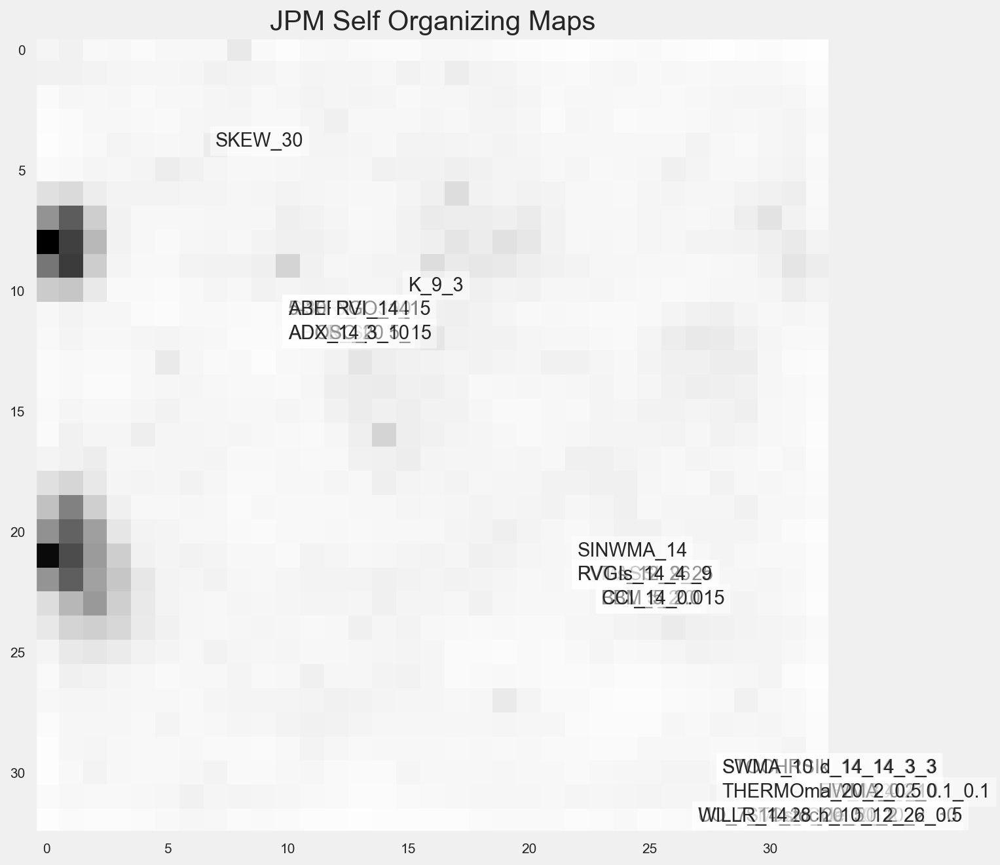

In [68]:
# Plot SOM
plt.figure(figsize=(20, 10))
for ix in range(len(JPM_train_filtered.columns)):
    winner_jpm = som_jpm.winner(JPM_train_filtered.values[ix])
    plt.text(winner_jpm[0], winner_jpm[1], JPM_train_filtered.columns[ix], bbox=dict(facecolor='white', alpha=0.5, lw=0)) 
plt.imshow(som_jpm.distance_map())
plt.grid(False)
plt.title('JPM Self Organizing Maps');
plt.savefig('JPM_SOM.png',bbox_inches="tight")
plt.show()

In [69]:
# Subsume corresponding features into a dataframe
JPM_som=np.zeros([len(JPM_train_filtered.columns),2])

for i in range(len(JPM_train_filtered.columns)):
    winner_jpm = som_jpm.winner(JPM_train_filtered.values[i])
    JPM_som[i,0]=winner_jpm[0]
    JPM_som[i,1]=winner_jpm[1]
    #print(winner_amd[0], winner_amd[1], AMD_train_filtered.columns[ix])
    
JPM_som = pd.DataFrame({'X': JPM_som[:,0], 'Y': JPM_som[:,1], 'Feature':JPM_train_filtered.columns})
JPM_som

,X,Y,Feature
0,10.0,11.0,Gold SMA 50
1,10.0,11.0,Gold SMA 150
2,10.0,11.0,Gold SMA 200
3,10.0,11.0,5-30 yield
4,10.0,11.0,5-10 yield
5,10.0,11.0,ABER_ZG_5_15
6,10.0,12.0,ABER_SG_5_15
7,10.0,12.0,ACCBL_20
8,10.0,12.0,AD
9,10.0,12.0,ADOSC_3_10


## Finalised feature slection analysis
We will now cross check the features clustering form the KMeans and SOM methods to select an appropriate number of relevant features. Generally, we will pick one feature per cluster.

The final selection algorithm will follow the following main step:
- Select one feature per cluster from  K-Means
- Check if the left out features are in different groups according to the SOM. If so, pick them too

### AMD final features

In [70]:
# Select one feature per KMeans cluster
n_clusters_amd=max(AMD_kmeans['Cluster'].values) # reads numbers of clusters
AMD_kmeans_features=list(np.zeros(n_clusters_amd)) # MIGHT IMPROVE LATER


# The loop selects one feature for each Kmeans cluster 
for k in range(n_clusters_amd):
    cluster_members=[]
    cluster_members=AMD_kmeans[AMD_kmeans['Cluster']==k]['Feature']
    AMD_kmeans_features[k]=cluster_members.iloc[rnd.randint(0,len(cluster_members))]

    
# Now we check which features are left out and if they belong to a different SOM cluster. If so, we pick them.
# This should allow to select the minimal number of features containing the maximum amount of information

# Make a copy of the SOM result for cross checking with Kmeans
AMD_cross_features=AMD_som.copy()
radius=np.arange(-1,2.5,0.5)

for k in range(n_clusters_amd):
    
    # Retrieves SOM coordinates corresponding to the feature selected from KMeans cluster
    coordinates=np.zeros(2)
    coordinates[0]=AMD_som[AMD_som['Feature']==AMD_kmeans_features[k]]['X']
    coordinates[1]=AMD_som[AMD_som['Feature']==AMD_kmeans_features[k]]['Y']
    
    # Drop all features in the same SOM cluster (defined as +-1 coordinates).
    
    for i in radius:
        for k in radius:
            AMD_cross_features=AMD_cross_features.drop(index=AMD_cross_features[(AMD_cross_features['X']==coordinates[0]+i) & (AMD_cross_features['Y']==coordinates[1]+k)].index)
    
    
    
# The features remaining are deemed to be different enough for the SOM algorithm.
# We add them to those selected by the KMeans algorithm to compile the final set of selected features
amd_final_features=np.array(AMD_kmeans_features+list(AMD_cross_features['Feature'].values))


# Now we drop all other features from the training and test datasets
AMD_train_filtered.drop(AMD_train_filtered.columns.difference(amd_final_features), 1, inplace=True)
AMD_val_filtered.drop(AMD_val_filtered.columns.difference(amd_final_features), 1, inplace=True)
AMD_test_filtered.drop(AMD_test_filtered.columns.difference(amd_final_features), 1, inplace=True)

# The final train dataset for AMD is then given by:
AMD_train_filtered.head()




,Real vol 8,Real vol 14,ATM 9,ATM 25,VIX 16,Gold SMA 50,5-10 yield,AD,ADOSC_3_10,DMP_14,OBVe_4,BIAS_SMA_26,CCI_14_0.015,CG_10,DPO_20,...,RVI_14,SKEW_30,STCmacd_10_12_26_0.5,TOS_STDEVALL_LR,TOS_STDEVALL_L_1,TOS_STDEVALL_U_1,TOS_STDEVALL_L_2,TRIX_30_9,UI_14,VAR_30,VHF_28,WCP,WILLR_14,ZL_EMA_10,ZS_30
Date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1990-10-15,1.877160,1.311489,-0.651724,-0.841608,1.216559,0.297943,0.093354,-1.349375,-0.158040,-0.872407,-0.895249,-1.419453,-0.503903,-2.066502,-0.015497,...,-0.299261,-1.189523,-0.314008,-1.004686,-1.004686,-1.004686,-1.004686,-1.004686,1.385492,-0.278550,1.050466,-1.182844,-0.470927,-1.187871,-0.792164
1990-10-16,1.879997,1.261321,-0.667620,-0.835553,1.270375,0.286400,0.077531,-1.348006,-0.134265,-0.891112,-0.897000,-1.504988,-0.525816,-1.723932,-0.066841,...,-0.730660,-1.007482,-0.320129,-1.004260,-1.004260,-1.004260,-1.004260,-1.018600,1.489443,-0.271909,0.965537,-1.191874,-0.572936,-1.186438,-0.798579
1990-10-17,1.805511,1.318535,-0.667620,-0.847663,1.089262,0.275351,0.061709,-1.351266,-0.132707,-0.908480,-0.898792,-1.753849,-0.527247,-1.666821,-0.216207,...,-1.069805,-0.888397,-0.335475,-1.003834,-1.003834,-1.003834,-1.003834,-1.034826,1.652136,-0.264484,0.876138,-1.200903,-0.776953,-1.194451,-0.866603
1990-10-18,1.860686,1.409340,-0.667620,-0.847663,1.025097,0.265828,0.061709,-1.351266,-0.117417,-0.924608,-0.899122,-1.500405,-0.439418,-1.398544,-0.076177,...,-0.412162,-0.727126,-0.336276,-1.003408,-1.003408,-1.003408,-1.003408,-1.051959,1.767300,-0.259982,0.960946,-1.197291,-0.674944,-1.195758,-0.731986
1990-10-19,1.131604,1.347063,-0.699412,-0.847663,1.074773,0.256491,0.030063,-1.349570,-0.085954,-0.899814,-0.898164,-1.244509,-0.343785,-0.711033,0.049850,...,0.067066,-0.654268,-0.325672,-1.002982,-1.002982,-1.002982,-1.002982,-1.068798,1.880784,-0.261759,0.701809,-1.191874,-0.572936,-1.195516,-0.622924


### JPM final features

In [71]:
# Select one feature per KMeans cluster
n_clusters_jpm=max(JPM_kmeans['Cluster'].values) # reads numbers of clusters
JPM_kmeans_features=list(np.zeros(n_clusters_jpm)) # MIGHT IMPROVE LATER


# The loop selects one feature for each Kmeans cluster 
for k in range(n_clusters_jpm):
    cluster_members=[]
    cluster_members=JPM_kmeans[JPM_kmeans['Cluster']==k]['Feature']
    JPM_kmeans_features[k]=cluster_members.iloc[rnd.randint(0,len(cluster_members))]

    
# Now we check which features are left out and if they belong to a different SOM cluster. If so, we pick them.
# This should allow to select the minimal number of features containing the maximum amount of information

# Make a copy of the SOM result for cross checking with Kmeans
JPM_cross_features=JPM_som.copy()
radius=np.arange(-1,2.5,0.5)

for k in range(n_clusters_jpm):
    
    # Retrieves SOM coordinates corresponding to the feature selected from KMeans cluster
    coordinates=np.zeros(2)
    coordinates[0]=JPM_som[JPM_som['Feature']==JPM_kmeans_features[k]]['X']
    coordinates[1]=JPM_som[JPM_som['Feature']==JPM_kmeans_features[k]]['Y']
    
    # Drop all features in the same SOM cluster. 
    for i in radius:
        for k in radius:
            JPM_cross_features=JPM_cross_features.drop(index=JPM_cross_features[(JPM_cross_features['X']==coordinates[0]+i) & (JPM_cross_features['Y']==coordinates[1]+k)].index)
    
# The features remaining are deemed to be different enough for the SOM algorithm.
# We add them to those selected by the KMeans algorithm to compile the final set of selected features
jpm_final_features=np.array(JPM_kmeans_features+list(JPM_cross_features['Feature'].values))


# Now we drop all other features from the training, validation and test datasets
JPM_train_filtered.drop(JPM_train_filtered.columns.difference(jpm_final_features), 1, inplace=True)
JPM_val_filtered.drop(JPM_val_filtered.columns.difference(jpm_final_features), 1, inplace=True)
JPM_test_filtered.drop(JPM_test_filtered.columns.difference(jpm_final_features), 1, inplace=True)

# The final train dataset for AMD is then given by:
JPM_train_filtered


,Gold SMA 150,5-10 yield,ADOSC_3_10,ADX_14,BBM_5_2.0,DPO_20,EFI_13,K_9_3,MASSI_9_25,NVI_1,PGO_14,PVT,SKEW_30,STCstoch_10_12_26_0.5,THERMOma_20_2_0.5
Date,,,,,,,,,,,,,,,
1990-10-15,0.247493,0.088468,-0.646008,2.324634,-1.112200,-0.103324,-0.435692,-0.699402,1.555874,0.740591,-1.120841,-1.427505,0.497935,-0.001144,-0.253098
1990-10-16,0.243071,0.072669,-0.652623,2.364110,-1.118290,-0.014416,-0.380926,-0.771199,1.428434,0.740591,-1.033720,-1.427505,0.637384,-0.001144,-0.275187
1990-10-17,0.238485,0.056873,-0.599186,2.414165,-1.124379,-0.076892,-0.353882,-0.896507,1.296583,0.693156,-1.186080,-1.431626,0.736907,-0.001144,-0.277615
1990-10-18,0.233994,0.056873,-0.606442,2.443603,-1.126206,0.002405,-0.310804,-0.980046,1.134750,0.693156,-1.073567,-1.431626,0.849934,-0.001144,-0.309073
1990-10-19,0.229094,0.025277,-0.526292,2.453245,-1.125901,0.177818,-0.261568,-0.973047,0.874517,0.693156,-0.825619,-1.429000,0.892127,-0.001144,-0.337535
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2009-06-12,0.547977,1.025277,-10.374720,-0.442052,0.002265,0.946947,-4.760692,-0.235057,-1.146384,-0.327558,-0.128731,12.742872,0.908020,-0.000663,0.412885
2009-06-15,0.555979,1.009479,-12.048867,-0.513586,-0.007892,-0.333908,-10.105527,-0.464544,-1.329032,-0.327558,-0.395769,12.590619,1.753530,-0.000903,0.432005
2009-06-16,0.563619,0.993681,-14.256173,-0.540274,-0.020752,-0.898499,-11.377877,-0.705134,-1.483430,-0.327558,-0.523000,12.519810,1.587914,-0.001024,0.418405


## Final correlation matrix
We present the final correlation matrix of the selected features

In [72]:
# Compute correlations
corrmatAMD=AMD_train_filtered.corr()
corrmatJPM=JPM_train_filtered.corr()

### AMD correlation heatmap

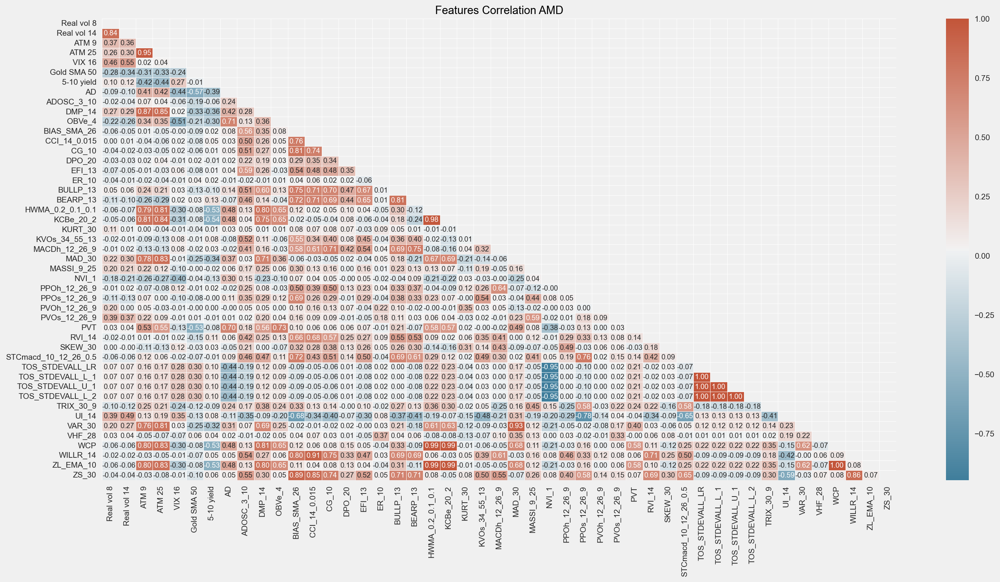

In [73]:
# We use the lower part of the matrix to avoid repetition of information. 
fig, ax=plt.subplots(figsize=(20,10))

mask = np.triu(np.ones_like(corrmatAMD, dtype=bool))
cmap=sns.diverging_palette(230, 20, as_cmap=True)

sns.heatmap(corrmatAMD, mask=mask,annot=True, annot_kws={'size': 9},fmt='0.2f',
            linewidths=0.4,square=False,cbar=True,cmap=cmap)
ax.set_title('Features Correlation AMD',fontsize=14,color='black')

plt.savefig('AMD_corrmat.png',bbox_inches="tight")

### JPM correlation heatmap

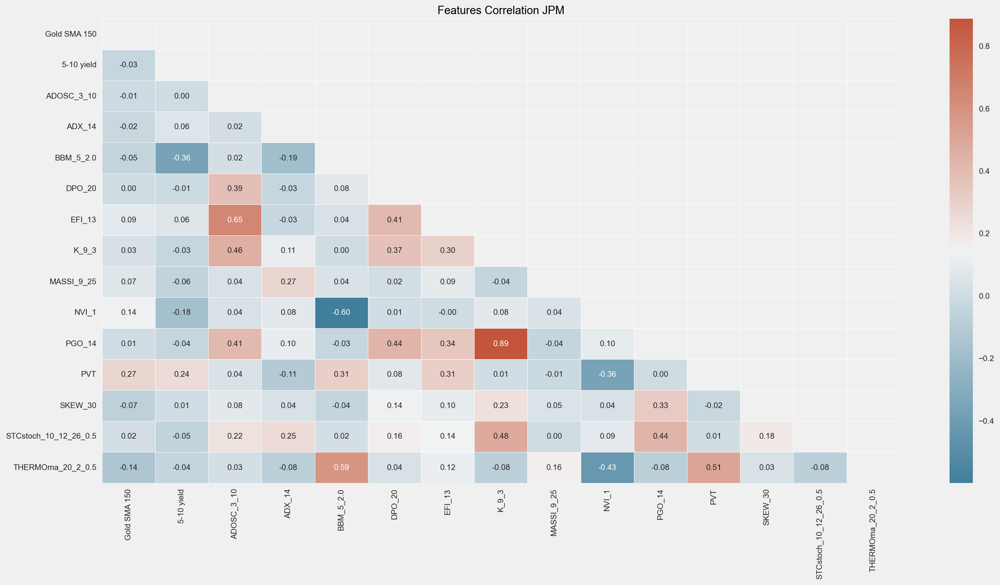

In [74]:
# We use the lower part of the matrix to avoid repetition of information. 
fig, ax=plt.subplots(figsize=(20,10))

mask = np.triu(np.ones_like(corrmatJPM, dtype=bool))
cmap=sns.diverging_palette(230, 20, as_cmap=True)

sns.heatmap(corrmatJPM, mask=mask,annot=True, annot_kws={'size': 10},fmt='0.2f',
            linewidths=0.4,square=False,cbar=True,cmap=cmap)
ax.set_title('Features Correlation JPM',fontsize=14,color='black')

plt.savefig('JPM_corrmat.png',bbox_inches="tight")

# Part II: Pipeline Formation

## Deep learning architecture construction

## Sequence generation
We exploit the Keras Timeseriesgenerator to transform the time series into data samples with the correct structure such that it can be fed to the LSTM Neural Network without worries

### AMD sequence

In [75]:
# Append a NaN values to the output array as the TimeseriesGenerator assumes that we are predicting the next time step
# While our target labels are defined on the same timetesp of the data

# train
yamd_train_shift=np.copy(yamd_train)
yamd_train_shift=np.insert(yamd_train_shift, 0, np.nan)

# validation
yamd_val_shift=np.copy(yamd_val)
yamd_val_shift=np.insert(yamd_val_shift, 0, np.nan)

# test
yamd_test_shift=np.copy(yamd_test)
yamd_test_shift=np.insert(yamd_test_shift, 0, np.nan)

# Generate train and test sequence data. lenght is the lookback period. We want a lookback period of approximately 1 month
lookback_amd=32
Input_AMD_train = TimeseriesGenerator(AMD_train_filtered, yamd_train_shift[:-1], length=lookback_amd,shuffle=False)
Input_AMD_val = TimeseriesGenerator(AMD_val_filtered, yamd_val_shift[:-1], length=lookback_amd,shuffle=False)
Input_AMD_test = TimeseriesGenerator(AMD_test_filtered, yamd_test_shift[:-1], length=lookback_amd,shuffle=False)


In [76]:
# Verify batch size
for i in range(len(Input_AMD_train)):
    a, b = Input_AMD_train[i]
    print(a.shape, b.shape)

(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(128, 32, 47) (128,)
(32, 32, 47) (32,)


## JPM sequence

In [77]:
# Append a NaN valuse to the output array as the TimeseriesGenerator assumes that we are predicting the next time step
# While our target labels are defined on the same timetesp of the data

# Train
yjpm_train_shift=np.copy(yjpm_train)
yjpm_train_shift=np.insert(yjpm_train_shift, 0, np.nan)

# Validation
yjpm_val_shift=np.copy(yjpm_val)
yjpm_val_shift=np.insert(yjpm_val_shift, 0, np.nan)

# Test
yjpm_test_shift=np.copy(yjpm_test)
yjpm_test_shift=np.insert(yjpm_test_shift, 0, np.nan)

# Generate train and test sequence data. lenght is the lookback period which we set at 21.
lookback_jpm=32
Input_JPM_train = TimeseriesGenerator(JPM_train_filtered, yjpm_train_shift[:-1], length=lookback_jpm,shuffle=False)
Input_JPM_val = TimeseriesGenerator(JPM_val_filtered, yjpm_val_shift[:-1], length=lookback_jpm,shuffle=False)
Input_JPM_test = TimeseriesGenerator(JPM_test_filtered, yjpm_test_shift[:-1], length=lookback_jpm,shuffle=False)


In [78]:
# Verify batch size
for i in range(len(Input_JPM_train)):
    a, b = Input_JPM_train[i]
    print(a.shape, b.shape)

(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(128, 32, 15) (128,)
(41, 32, 15) (41,)


## Create Neural Network

### Create path to store results

In [79]:
results_path_amd = Path('results', 'AMD')
if not results_path_amd.exists():
    results_path_amd.mkdir(parents=True)
    
results_path_jpm = Path('results', 'JPM')
if not results_path_jpm.exists():
    results_path_jpm.mkdir(parents=True)

### Read feature number

In [80]:
# Read number of features 
amd_numfeat=len(AMD_train_filtered.columns.values)
jpm_numfeat=len(JPM_train_filtered.columns.values)

### Optimizable general neural network

In [81]:
def NN_TUNER(hyper_param,lookback,numfeat):
    
    tf.keras.backend.clear_session()
    
    # Setup model
    model=Sequential()
    
    # Tunable neurons for fixed amount of layers
    
    # LSTM
    hyper_param_lstm1=hyper_param.Int('lstm_neurons1',min_value=0,max_value=50, step=2)
    hyper_param_lstm2=hyper_param.Int('lstm_neurons2',min_value=0,max_value=50, step=2)
    #hyper_param_lstm3=hyper_param.Int('lstm_neurons3',min_value=0,max_value=50, step=2)
    
    # GRU
    hyper_param_gru1=hyper_param.Int('gru_neurons1',min_value=0,max_value=50, step=2)
    hyper_param_gru2=hyper_param.Int('gru_neurons2',min_value=0,max_value=50, step=2)
    #hyper_param_gru3=hyper_param.Int('gru_neurons3',min_value=0,max_value=50, step=2)
    
    # Tunable dropout rate
    # LSTM
    hyper_param_lstm_dropout1=hyper_param.Float('Dropout_rate_lstm1',min_value=0,max_value=0.6,step=0.1)
    hyper_param_lstm_dropout2=hyper_param.Float('Dropout_rate_lstm2',min_value=0,max_value=0.6,step=0.1)
    
    # GRU
    hyper_param_gru_dropout1=hyper_param.Float('Dropout_rate_gru1',min_value=0,max_value=0.6,step=0.1)
    hyper_param_gru_dropout2=hyper_param.Float('Dropout_rate_gru2',min_value=0,max_value=0.6,step=0.1)
    
    # Output dropout
    hyper_param_out_dropout=hyper_param.Float('Dropout_rate_out',min_value=0,max_value=0.6,step=0.1)
    
    # Tunable activation functions
    hyper_param_activation=hyper_param.Choice(name='activation',values=['relu','elu'],ordered=False)
        
    
    # Layers:
    
    #1
    model.add(LSTM(units=hyper_param_lstm1, input_shape=(lookback,numfeat), dropout=hyper_param_lstm_dropout1,
                   activation = hyper_param_activation, return_sequences=True, name='LSTM1'))
    
    #2
    model.add(GRU(hyper_param_gru1, dropout=hyper_param_gru_dropout1,
                  activation = hyper_param_activation, return_sequences=True, name='GRU1'))
    
    #3
    model.add(LSTM(hyper_param_lstm2, dropout=hyper_param_lstm_dropout2,
                   activation = hyper_param_activation, return_sequences=True, name='LSTM2'))
    #4
    model.add(GRU(hyper_param_gru2, dropout=hyper_param_gru_dropout2,
                  activation = hyper_param_activation, return_sequences=False, name='GRU2'))
    
    
    # Output
    model.add(Dropout(rate=hyper_param_out_dropout,seed=42,name='DropOutput'))
    model.add(Dense(units=1, activation='sigmoid', name='Output'))
    
    # Specify optimizer separately (preferred method))
    opt = Adam(lr=0.002, epsilon=1e-08, decay=0.0) 
    
    # Model compilation 
    model.compile(optimizer=opt, 
                  loss=BinaryCrossentropy(), 
                  metrics=[BinaryAccuracy(), 
                           Precision(),
                           Recall(),
                           AUC()])
    
    return model

## AMD Neural Network

### Specifying callack functions for tuning and fitting

In [82]:
# Specify callback functions
model_path_amd = (results_path_amd / 'model.h5').as_posix()

# AMD callbacks for tuning pnly need an early stopping function
amd_callbacks_tuner = [
    EarlyStopping(patience=10, monitor='val_loss', mode='min', verbose=1, restore_best_weights=True)]

# AMD callbacks for fitting include a ModelCheckpoint
amd_callbacks_fitting = [
    EarlyStopping(patience=15, monitor='val_binary_accuracy', mode='max', verbose=2, restore_best_weights=True),
    ModelCheckpoint(filepath=model_path_amd, verbose=1, monitor='val_binary_accuracy', mode='max',save_best_only=True)]

## Hyperparameter tuning

In [83]:
# We use the partial functool to pass the lookback and feature numbers
LSTM_TUNER_AMD=partial(NN_TUNER,lookback=lookback_amd,numfeat=amd_numfeat)

In [84]:
# BayesianOptimization algorithm from keras tuner
LSTMtuner_amd = BayesianOptimization(
    LSTM_TUNER_AMD,
    objective="val_binary_accuracy",
    max_trials=10,
    beta=3,
    hyperparameters=None,
    tune_new_entries=True,
    allow_new_entries=True,
    overwrite=True,
    directory="./keras",
    project_name="LSTMtuner_amd")

In [85]:
# Launch tuning process
LSTMtuner_amd.search(Input_AMD_train,epochs=50, callbacks=amd_callbacks_tuner, validation_data=Input_AMD_val,class_weight = class_weightAMD, shuffle=False)

Trial 10 Complete [00h 01m 19s]
val_binary_accuracy: 0.5219960808753967

Best val_binary_accuracy So Far: 0.7321076989173889
Total elapsed time: 00h 21m 22s
INFO:tensorflow:Oracle triggered exit


In [87]:
# Save and display the best hyperparameter values for the model based on the defined objective function
bestparam_amd = LSTMtuner_amd.get_best_hyperparameters()[0]

print(bestparam_amd.values)

{'lstm_neurons1': 30, 'lstm_neurons2': 20, 'gru_neurons1': 2, 'gru_neurons2': 8, 'Dropout_rate_lstm1': 0.0, 'Dropout_rate_lstm2': 0.2, 'Dropout_rate_gru1': 0.4, 'Dropout_rate_gru2': 0.5, 'Dropout_rate_out': 0.4, 'activation': 'elu'}


### Training of AMD network

In [117]:
# Build the model with the optimal hyperparameters and train it on the data for 100 epochs or until stopped
AMD_NN = LSTMtuner_amd.hypermodel.build(bestparam_amd)

AMD_NN.fit(Input_AMD_train,
          epochs=100, 
          verbose=1,
          validation_data=Input_AMD_val,                                           
          callbacks=amd_callbacks_fitting, 
          shuffle=False,
          class_weight=class_weightAMD)

Epoch 1/100
37/37 [==============================] - 8s 93ms/step - loss: 0.7129 - binary_accuracy: 0.4994 - precision: 0.4911 - recall: 0.4711 - auc: 0.5079 - val_loss: 0.6965 - val_binary_accuracy: 0.4819 - val_precision: 0.4755 - val_recall: 0.8132 - val_auc: 0.4825

Epoch 00001: val_binary_accuracy did not improve from 0.55417
Epoch 2/100
37/37 [==============================] - 2s 45ms/step - loss: 0.6896 - binary_accuracy: 0.5379 - precision: 0.5283 - recall: 0.5714 - auc: 0.5530 - val_loss: 0.6983 - val_binary_accuracy: 0.4760 - val_precision: 0.4711 - val_recall: 0.7830 - val_auc: 0.4794

Epoch 00002: val_binary_accuracy did not improve from 0.55417
Epoch 3/100
37/37 [==============================] - 2s 45ms/step - loss: 0.6839 - binary_accuracy: 0.5623 - precision: 0.5539 - recall: 0.5692 - auc: 0.5870 - val_loss: 0.7140 - val_binary_accuracy: 0.4898 - val_precision: 0.4360 - val_recall: 0.2294 - val_auc: 0.4760

Epoch 00003: val_binary_accuracy did not improve from 0.55417
E

37/37 [==============================] - 3s 79ms/step - loss: 0.4128 - binary_accuracy: 0.8196 - precision: 0.8701 - recall: 0.7447 - auc: 0.8994 - val_loss: 0.8838 - val_binary_accuracy: 0.5601 - val_precision: 0.7302 - val_recall: 0.1264 - val_auc: 0.6902

Epoch 00025: val_binary_accuracy did not improve from 0.62377
Epoch 26/100
37/37 [==============================] - 3s 71ms/step - loss: 0.4206 - binary_accuracy: 0.8196 - precision: 0.7886 - recall: 0.8656 - auc: 0.8952 - val_loss: 0.6500 - val_binary_accuracy: 0.6336 - val_precision: 0.6032 - val_recall: 0.6827 - val_auc: 0.6716

Epoch 00026: val_binary_accuracy improved from 0.62377 to 0.63362, saving model to results/AMD\model.h5
Epoch 27/100
37/37 [==============================] - 4s 119ms/step - loss: 0.4224 - binary_accuracy: 0.8134 - precision: 0.8389 - recall: 0.7684 - auc: 0.8919 - val_loss: 0.6678 - val_binary_accuracy: 0.6021 - val_precision: 0.6704 - val_recall: 0.3297 - val_auc: 0.7141

Epoch 00027: val_binary_accura

37/37 [==============================] - 3s 82ms/step - loss: 0.3232 - binary_accuracy: 0.8700 - precision: 0.8662 - recall: 0.8704 - auc: 0.9371 - val_loss: 0.6198 - val_binary_accuracy: 0.6875 - val_precision: 0.7019 - val_recall: 0.6016 - val_auc: 0.7669

Epoch 00049: val_binary_accuracy did not improve from 0.69468
Epoch 50/100
37/37 [==============================] - 3s 81ms/step - loss: 0.3232 - binary_accuracy: 0.8694 - precision: 0.8831 - recall: 0.8468 - auc: 0.9372 - val_loss: 0.6006 - val_binary_accuracy: 0.6999 - val_precision: 0.7175 - val_recall: 0.6140 - val_auc: 0.7785

Epoch 00050: val_binary_accuracy improved from 0.69468 to 0.69993, saving model to results/AMD\model.h5
Epoch 51/100
37/37 [==============================] - 3s 85ms/step - loss: 0.3267 - binary_accuracy: 0.8647 - precision: 0.8575 - recall: 0.8695 - auc: 0.9363 - val_loss: 0.6878 - val_binary_accuracy: 0.6487 - val_precision: 0.6164 - val_recall: 0.7019 - val_auc: 0.7373

Epoch 00051: val_binary_accurac

In [118]:
# load model - os.path.abspath(model_path)
AMD_NN_final = load_model(model_path_amd)
AMD_NN_final.compile(optimizer=Adam(lr=0.002, epsilon=1e-08, decay=0.0) , 
                  loss=BinaryCrossentropy(), 
                  metrics=[BinaryAccuracy(), 
                           Precision(),
                           Recall(),
                           AUC()])
# summarize model
AMD_NN_final.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM1 (LSTM)                 (None, 32, 30)            9360      
_________________________________________________________________
GRU1 (GRU)                   (None, 32, 2)             204       
_________________________________________________________________
LSTM2 (LSTM)                 (None, 32, 20)            1840      
_________________________________________________________________
GRU2 (GRU)                   (None, 8)                 720       
_________________________________________________________________
DropOutput (Dropout)         (None, 8)                 0         
_________________________________________________________________
Output (Dense)               (None, 1)                 9         
Total params: 12,133
Trainable params: 12,133
Non-trainable params: 0
____________________________________________________

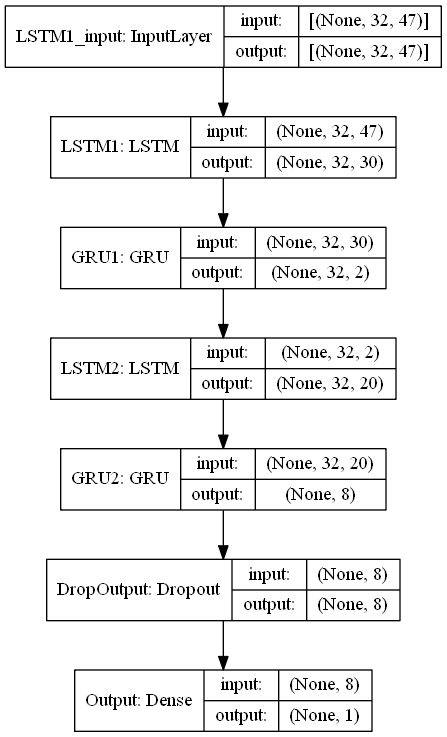

In [90]:
# Plot of layers
plot_model(AMD_NN_final, to_file='./amd_model.png', show_shapes=True, show_layer_names=True)

## JPM Neural Network

### Specifying tuning and callback functions

In [91]:
# Specify callback functions
model_path_jpm = (results_path_jpm / 'model.h5').as_posix()

# JPM callbacks for tuning pnly need an early stopping function
jpm_callbacks_tuner = [
    EarlyStopping(patience=10, monitor='val_loss', mode='min', verbose=1, restore_best_weights=True)]

# JPM callbacks for fitting include a ModelCheckpoint
jpm_callbacks_fitting = [
    EarlyStopping(patience=15, monitor='val_binary_accuracy', mode='max', verbose=2, restore_best_weights=True),
    ModelCheckpoint(filepath=model_path_jpm, verbose=1, monitor='val_binary_accuracy', mode='max',save_best_only=True)]

## Hyperparameter tuning for JPM

In [92]:
# We use the partial functool to pass the lookback and feature number parameters
TUNER_JPM=partial(NN_TUNER,lookback=lookback_jpm,numfeat=jpm_numfeat)

In [93]:
# BayesianOptimization algorithm from keras tuner
LSTMtuner_jpm = BayesianOptimization(
    TUNER_JPM,
    objective="val_binary_accuracy",
    max_trials=15,
    beta=3,
    hyperparameters=None,
    tune_new_entries=True,
    allow_new_entries=True,
    overwrite=True,
    directory="./keras",
    project_name="LSTMtuner_jpm")

In [94]:
# Launch tuning process
LSTMtuner_jpm.search(Input_JPM_train,epochs=50, callbacks=jpm_callbacks_tuner, validation_data=Input_JPM_val,class_weight = class_weightJPM, shuffle=False)

Trial 15 Complete [00h 02m 05s]
val_binary_accuracy: 0.44262295961380005

Best val_binary_accuracy So Far: 0.8124589920043945
Total elapsed time: 00h 50m 25s
INFO:tensorflow:Oracle triggered exit


In [96]:
# Save and display the best hyperparameter values for the model based on the defined objective function
bestparam_jpm = LSTMtuner_jpm.get_best_hyperparameters()[0]

print(bestparam_jpm.values)

{'lstm_neurons1': 50, 'lstm_neurons2': 50, 'gru_neurons1': 50, 'gru_neurons2': 50, 'Dropout_rate_lstm1': 0.0, 'Dropout_rate_lstm2': 0.0, 'Dropout_rate_gru1': 0.0, 'Dropout_rate_gru2': 0.6000000000000001, 'Dropout_rate_out': 0.0, 'activation': 'relu'}


### Trainin of JPM Network

In [97]:
# Build the model with the optimal hyperparameters and train it on the data for 100 epochs or until stopped
JPM_NN = LSTMtuner_jpm.hypermodel.build(bestparam_jpm)

JPM_NN.fit(Input_JPM_train,
          epochs=100, 
          verbose=1,
          validation_data=Input_JPM_val,                                           
          callbacks=jpm_callbacks_fitting, 
          shuffle=False,
          class_weight=class_weightJPM)

Epoch 1/100
37/37 [==============================] - 20s 385ms/step - loss: 0.6987 - binary_accuracy: 0.4898 - precision: 0.5302 - recall: 0.2653 - auc: 0.5241 - val_loss: 1.3175 - val_binary_accuracy: 0.5692 - val_precision: 0.5754 - val_recall: 0.8659 - val_auc: 0.5221

Epoch 00001: val_binary_accuracy improved from -inf to 0.56918, saving model to results/JPM\model.h5
Epoch 2/100
37/37 [==============================] - 12s 323ms/step - loss: 0.7066 - binary_accuracy: 0.5692 - precision: 0.6032 - recall: 0.5294 - auc: 0.6056 - val_loss: 0.7252 - val_binary_accuracy: 0.5095 - val_precision: 0.6992 - val_recall: 0.2106 - val_auc: 0.6418

Epoch 00002: val_binary_accuracy did not improve from 0.56918
Epoch 3/100
37/37 [==============================] - 12s 315ms/step - loss: 0.6742 - binary_accuracy: 0.6178 - precision: 0.6221 - recall: 0.6966 - auc: 0.6456 - val_loss: 0.6622 - val_binary_accuracy: 0.6315 - val_precision: 0.6915 - val_recall: 0.6118 - val_auc: 0.6658

Epoch 00003: val_b

37/37 [==============================] - 9s 251ms/step - loss: 0.3119 - binary_accuracy: 0.8671 - precision: 0.8840 - recall: 0.8602 - auc: 0.9407 - val_loss: 0.4224 - val_binary_accuracy: 0.8013 - val_precision: 0.8711 - val_recall: 0.7553 - val_auc: 0.9041

Epoch 00024: val_binary_accuracy did not improve from 0.83016
Epoch 25/100
37/37 [==============================] - 11s 293ms/step - loss: 0.3078 - binary_accuracy: 0.8643 - precision: 0.8799 - recall: 0.8594 - auc: 0.9423 - val_loss: 0.4309 - val_binary_accuracy: 0.8144 - val_precision: 0.8006 - val_recall: 0.8882 - val_auc: 0.8952

Epoch 00025: val_binary_accuracy did not improve from 0.83016
Epoch 26/100
37/37 [==============================] - 11s 310ms/step - loss: 0.3028 - binary_accuracy: 0.8696 - precision: 0.8879 - recall: 0.8610 - auc: 0.9439 - val_loss: 0.5183 - val_binary_accuracy: 0.7613 - val_precision: 0.8997 - val_recall: 0.6435 - val_auc: 0.8971

Epoch 00026: val_binary_accuracy did not improve from 0.83016
Epoch 

In [98]:
# Load best model
JPM_NN_final = load_model(model_path_jpm)
JPM_NN_final.compile(optimizer=Adam(lr=0.002, epsilon=1e-08, decay=0.0) , 
                  loss=BinaryCrossentropy(), 
                  metrics=[BinaryAccuracy(), 
                           Precision(),
                           Recall(),
                           AUC()])
# summarize model
JPM_NN_final.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM1 (LSTM)                 (None, 32, 50)            13200     
_________________________________________________________________
GRU1 (GRU)                   (None, 32, 50)            15300     
_________________________________________________________________
LSTM2 (LSTM)                 (None, 32, 50)            20200     
_________________________________________________________________
GRU2 (GRU)                   (None, 50)                15300     
_________________________________________________________________
DropOutput (Dropout)         (None, 50)                0         
_________________________________________________________________
Output (Dense)               (None, 1)                 51        
Total params: 64,051
Trainable params: 64,051
Non-trainable params: 0
____________________________________________________

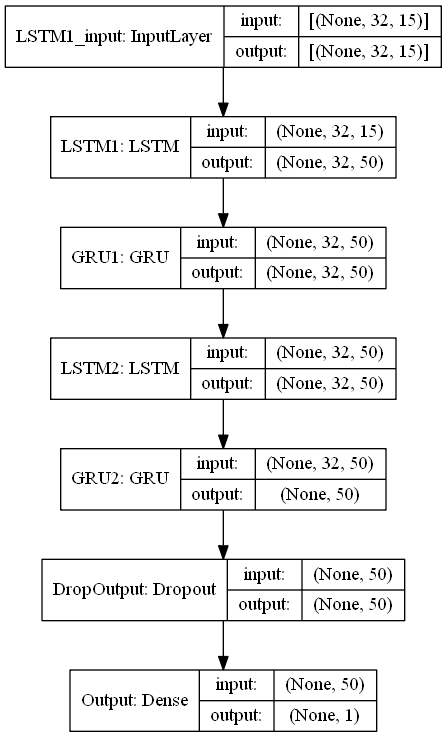

In [99]:
# Plot of layers
plot_model(JPM_NN_final, to_file='./jpm_model.png', show_shapes=True, show_layer_names=True)

# Performance Evaluation

## AMD Train and Test accuracy

In [119]:
# predictions 
yamd_pred = np.where(AMD_NN_final.predict(Input_AMD_test, verbose=False) > 0.5, 1, 0)

acc_train = accuracy_score(yamd_train[lookback_amd:], np.where(AMD_NN_final.predict(Input_AMD_train)>0.5,1,0))
acc_test = accuracy_score(yamd_test[lookback_amd:], yamd_pred)
print(f'Train Accuracy: {acc_train:0.4}, Test Accuracy: {acc_test:0.4}')

Train Accuracy: 0.8198, Test Accuracy: 0.6139


## AMD classification report

In [120]:
# Classification Report
print(classification_report(yamd_test[lookback_amd:], yamd_pred))

              precision    recall  f1-score   support

         0.0       0.52      0.78      0.63       636
         1.0       0.76      0.50      0.60       892

    accuracy                           0.61      1528
   macro avg       0.64      0.64      0.61      1528
weighted avg       0.66      0.61      0.61      1528



## AMD Confusion Matrix

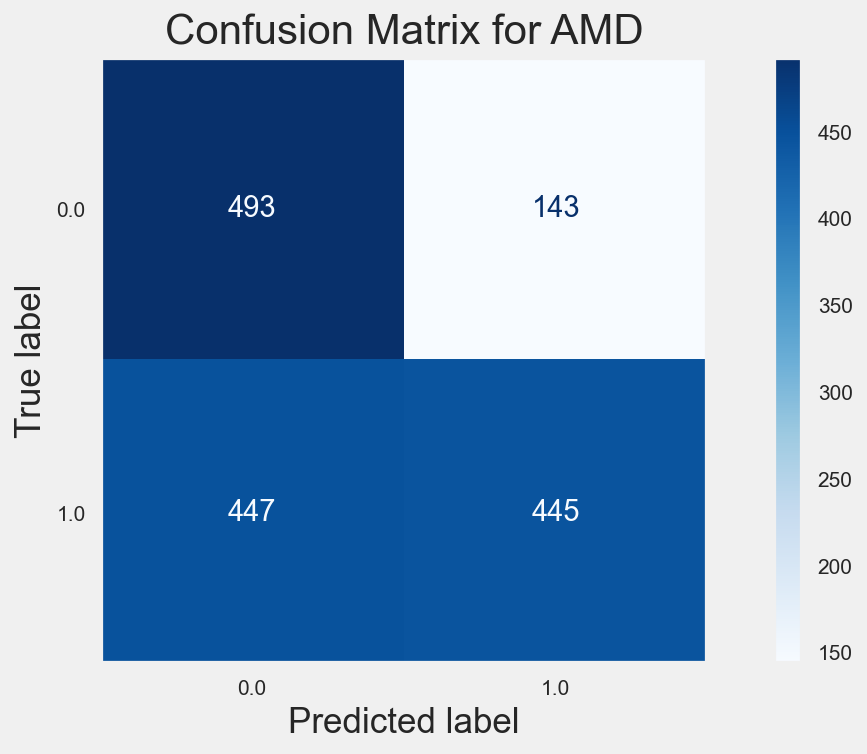

In [121]:
# Confusion Matrix for binary classification
ConfusionMatrixDisplay.from_predictions(yamd_test[lookback_amd:], yamd_pred,cmap='Blues')
plt.title('Confusion Matrix for AMD')
plt.grid(False)
plt.savefig('AMD_confusion.png',bbox_inches="tight")
plt.show()


## AMD Area under ROC curve

In [122]:
pred_raw_amd=AMD_NN_final.predict(Input_AMD_test, verbose=False)

# Predict Probabilities
preds1_amd = 1-pred_raw_amd[:] # Storing probability of down move 
preds2_amd = pred_raw_amd[:]   # Storing probability of up move 

fpr1, tpr1, threshold1 = roc_curve(yamd_test[lookback_amd:], preds1_amd, pos_label=0)
roc_auc1 = auc(fpr1, tpr1)

fpr2, tpr2, threshold2 = roc_curve(yamd_test[lookback_amd:], preds2_amd, pos_label=1)
roc_auc2 = auc(fpr2, tpr2)

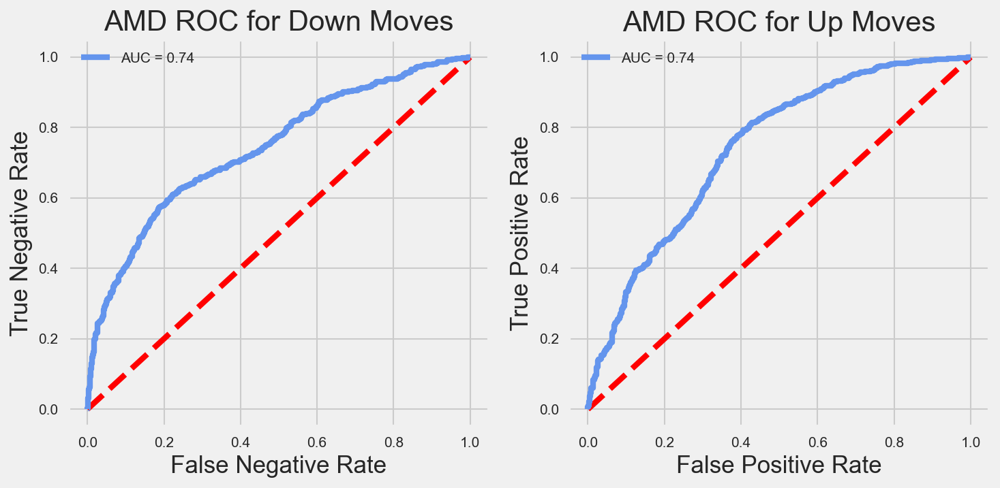

In [123]:
fig, ax = plt.subplots(1,2)

ax[0].plot([0, 1], [0, 1], 'r--')
ax[0].plot(fpr1, tpr1, 'cornflowerblue', label=f'AUC = {roc_auc1:0.2}')
ax[0].set_title("AMD ROC for Down Moves")
ax[0].set_xlabel('False Negative Rate')
ax[0].set_ylabel('True Negative Rate')

ax[1].plot([0, 1], [0, 1], 'r--')
ax[1].plot(fpr2, tpr2, 'cornflowerblue', label=f'AUC = {roc_auc2:0.2}')
ax[1].set_title("AMD ROC for Up Moves")
ax[1].set_xlabel('False Positive Rate')
ax[1].set_ylabel('True Positive Rate')

# Define legend
ax[0].legend(), ax[1].legend();
fig.tight_layout()

plt.savefig('AMD_ROC.png',bbox_inches="tight")

## AMD Probability scatter plots

In [124]:
# Separates correclty and incorrectly predicted values for the scatter plot

# Initialising lists
trueups=np.empty(len(yamd_test[lookback_amd:]))
trueups[:]=np.NaN
falseups=np.empty(len(yamd_test[lookback_amd:]))
falseups[:]=np.NaN
truedown=np.empty(len(yamd_test[lookback_amd:]))
truedown[:]=np.NaN
falsedown=np.empty(len(yamd_test[lookback_amd:]))
falsedown[:]=np.NaN

# Create a time axis representing the steps 
timesteps=np.linspace(1,len(yamd_test[lookback_amd:]),len(yamd_test[lookback_amd:]))


# The probabilities of true/false negative/positives are slotted in the correct list
for i in range(len(yamd_test[lookback_amd:])):
    if yamd_pred[i]==yamd_test[lookback_amd:][i]:
        if yamd_test[lookback_amd:][i]==1:
            trueups[i]=pred_raw_amd[i]
        else:
            truedown[i]=1-pred_raw_amd[i]
    else:
        if yamd_test[lookback_amd:][i]==1:
            falseups[i]=pred_raw_amd[i]
        else:
            falsedown[i]=1-pred_raw_amd[i]

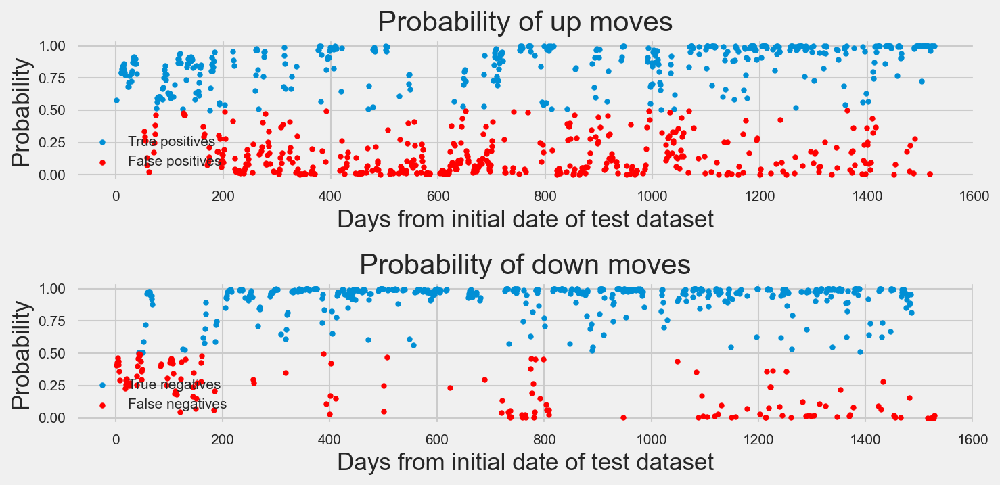

In [125]:
fig, (ax1,ax2)=plt.subplots(2,1)

# Up moves
ax1.scatter(timesteps,trueups,label='True positives',marker='.')
ax1.scatter(timesteps,falseups,label='False positives',marker='.',color='red')
ax1.set_title('Probability of up moves')
ax1.set_xlabel('Days from initial date of test dataset')
ax1.set_ylabel('Probability')
ax1.legend(loc='lower left')

# Down moves
ax2.scatter(timesteps,truedown,label='True negatives',marker='.')
ax2.scatter(timesteps,falsedown,label='False negatives',marker='.',color='red')
ax2.set_title('Probability of down moves')
ax2.set_xlabel('Days from initial date of test dataset')
ax2.set_ylabel('Probability')
ax2.legend(loc='lower left')

fig.tight_layout()

plt.savefig('AMD_scatter.png',bbox_inches="tight")

## JPM Train and Test accuracy

In [109]:
# predictions 
yjpm_pred = np.where(JPM_NN_final.predict(Input_JPM_test, verbose=False) > 0.5, 1, 0)

acc_train = accuracy_score(yjpm_train[lookback_jpm:], np.where(JPM_NN_final.predict(Input_JPM_train)>0.5,1,0))
acc_test = accuracy_score(yjpm_test[lookback_jpm:], yjpm_pred)
print(f'Train Accuracy: {acc_train:0.4}, Test Accuracy: {acc_test:0.4}')

Train Accuracy: 0.7879, Test Accuracy: 0.7707


## JPM Classification report

In [110]:
# Classification Report
print(classification_report(yjpm_test[lookback_jpm:], yjpm_pred))

              precision    recall  f1-score   support

         0.0       0.77      0.68      0.72       674
         1.0       0.77      0.84      0.80       857

    accuracy                           0.77      1531
   macro avg       0.77      0.76      0.76      1531
weighted avg       0.77      0.77      0.77      1531



## JPM Confusion Matrix

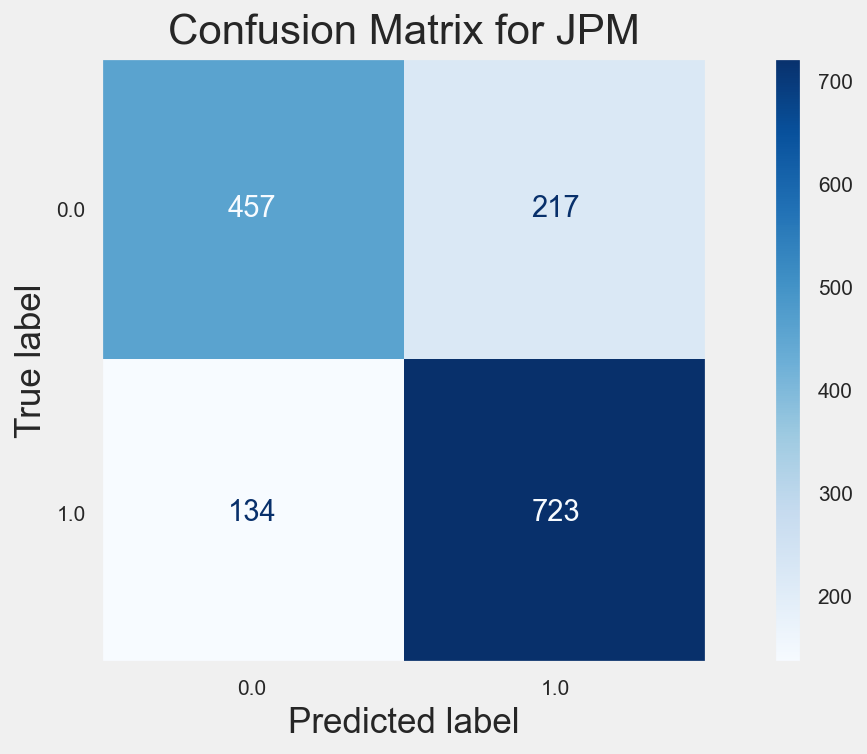

In [111]:
# Confusion Matrix for binary classification
ConfusionMatrixDisplay.from_predictions(yjpm_test[lookback_jpm:], yjpm_pred,cmap='Blues')
plt.title('Confusion Matrix for JPM')
plt.grid(False)
plt.savefig('JPM_confusion.png',bbox_inches="tight")
plt.show()

## JPM Area under the ROC curve

In [112]:
pred_raw_jpm=JPM_NN_final.predict(Input_JPM_test, verbose=False)

# Predict Probabilities
preds1_jpm = 1-pred_raw_jpm[:] # Storing probability of down move 
preds2_jpm = pred_raw_jpm[:]   # Storing probability of up move 

fpr1, tpr1, threshold1 = roc_curve(yjpm_test[lookback_jpm:], preds1_jpm, pos_label=0)
roc_auc1 = auc(fpr1, tpr1)

fpr2, tpr2, threshold2 = roc_curve(yjpm_test[lookback_jpm:], preds2_jpm, pos_label=1)
roc_auc2 = auc(fpr2, tpr2)

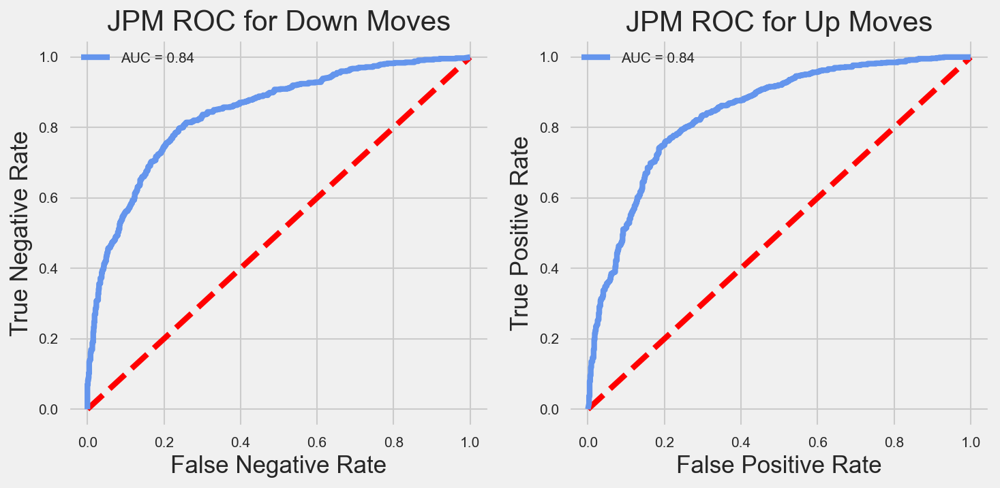

In [113]:
fig, ax = plt.subplots(1,2)

ax[0].plot([0, 1], [0, 1], 'r--')
ax[0].plot(fpr1, tpr1, 'cornflowerblue', label=f'AUC = {roc_auc1:0.2}')
ax[0].set_title("JPM ROC for Down Moves")
ax[0].set_xlabel('False Negative Rate')
ax[0].set_ylabel('True Negative Rate')

ax[1].plot([0, 1], [0, 1], 'r--')
ax[1].plot(fpr2, tpr2, 'cornflowerblue', label=f'AUC = {roc_auc2:0.2}')
ax[1].set_title("JPM ROC for Up Moves")
ax[1].set_xlabel('False Positive Rate')
ax[1].set_ylabel('True Positive Rate')

# Define legend
ax[0].legend(), ax[1].legend();
fig.tight_layout()

plt.savefig('JPM_ROC.png',bbox_inches="tight")

## JPM Probability scatterplots

In [114]:
# Separates correclty and incorrectly predicted values for the scatter plot

# Initialising lists as arrays of nan. This allows to have clearer plots later
trueups=np.empty(len(yjpm_test[lookback_jpm:]))
trueups[:]=np.NaN
falseups=np.empty(len(yjpm_test[lookback_jpm:]))
falseups[:]=np.NaN
truedown=np.empty(len(yjpm_test[lookback_jpm:]))
truedown[:]=np.NaN
falsedown=np.empty(len(yjpm_test[lookback_jpm:]))
falsedown[:]=np.NaN

# Create a time axis representing the steps 
timesteps=np.linspace(1,len(yjpm_test[lookback_jpm:]),len(yjpm_test[lookback_jpm:]))


# The probabilities of true/false negative/positives are slotted in the correct list
for i in range(len(yjpm_test[lookback_jpm:])):
    if yjpm_pred[i]==yjpm_test[lookback_jpm:][i]:
        if yjpm_test[lookback_jpm:][i]==1:
            trueups[i]=pred_raw_jpm[i]
        else:
            truedown[i]=1-pred_raw_jpm[i]
    else:
        if yjpm_test[lookback_jpm:][i]==1:
            falseups[i]=pred_raw_jpm[i]
        else:
            falsedown[i]=1-pred_raw_jpm[i]

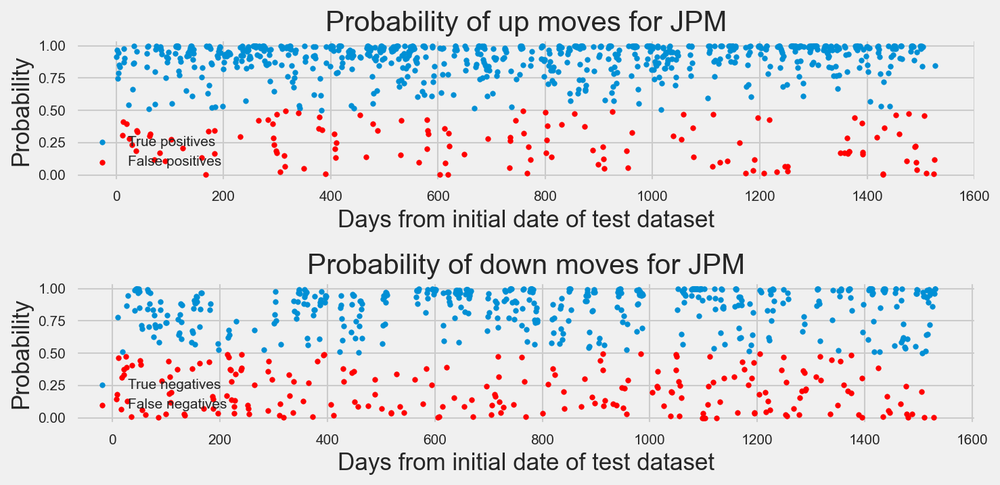

In [115]:
fig, (ax1,ax2)=plt.subplots(2,1)

# Up moves
ax1.scatter(timesteps,trueups,label='True positives',marker='.')
ax1.scatter(timesteps,falseups,label='False positives',marker='.',color='red')
ax1.set_title('Probability of up moves for JPM')
ax1.set_xlabel('Days from initial date of test dataset')
ax1.set_ylabel('Probability')
ax1.legend(loc='lower left')

# Down moves
ax2.scatter(timesteps,truedown,label='True negatives',marker='.')
ax2.scatter(timesteps,falsedown,label='False negatives',marker='.',color='red')
ax2.set_title('Probability of down moves for JPM')
ax2.set_xlabel('Days from initial date of test dataset')
ax2.set_ylabel('Probability')
ax2.legend(loc='lower left')

fig.tight_layout()

plt.savefig('JPM_scatter.png',bbox_inches="tight")

# Volatility modelling

The deep learning algorithm for price direction forecasting is completed. The following section is used to draw a connection with the advanced volatility modeling elective. Check Appendix A of the report for more information.

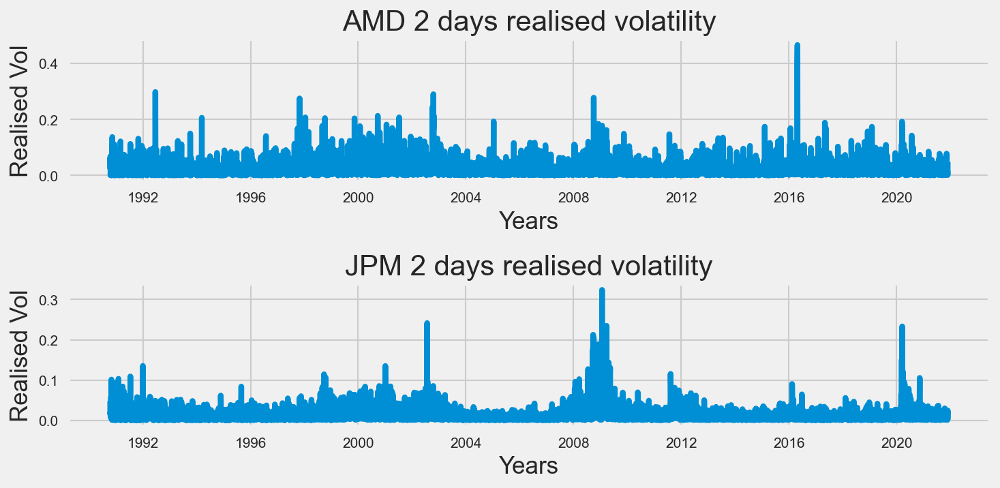

In [154]:
# Plots of volatilities 
fig, ax=plt.subplots(2,1)
ax[0].plot(AMDfeat.index,AMDfeat['Real vol 2'])
ax[0].set_xlabel('Years')
ax[0].set_ylabel('Realised Vol')
ax[0].set_title('AMD 2 days realised volatility')

ax[1].plot(JPMfeat.index,JPMfeat['Real vol 2'])
ax[1].set_xlabel('Years')
ax[1].set_ylabel('Realised Vol')
ax[1].set_title('JPM 2 days realised volatility')

fig.tight_layout()
plt.savefig('real_vol.png',bbox_inches="tight")

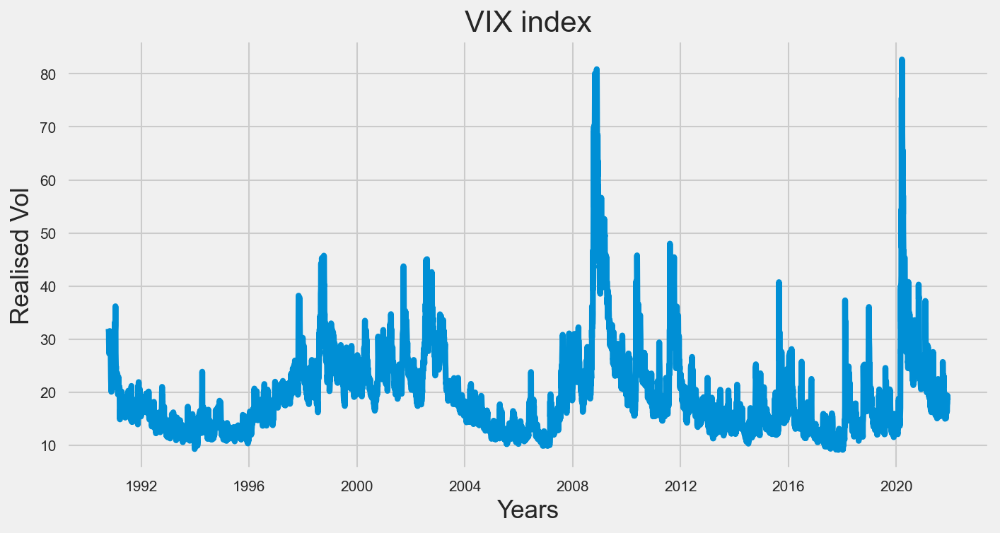

In [156]:
# Plot of VIX
plt.plot(AMDfeat.index,AMDfeat['VIX 1'])
plt.xlabel('Years')
plt.ylabel('Realised Vol')
plt.title('VIX index')

plt.savefig('VIX.png',bbox_inches="tight")
plt.show()